In [297]:
%run "Eigendecomposition_Source_Code.ipynb"

Loading: Eigendecomposition_Source_Code.ipynb...
Done at: 2023/08/15 12:09:20


In [48]:
%run "../code/Basics_Source_Code.ipynb"

	Loading analysis source code...
	Done!


In [181]:
import pickle
file = open('/home/jovyan/work/Human_Hippocampus/StitchedDataUpdated.pkl', 'rb')
stitched_data = pickle.load(file)
file.close()

## Setup

In [ ]:
interact_manual( ColorSelect, selection=colors )

In [49]:
interact_manual( loadData, FolderName=data_folders)

interactive(children=(Dropdown(description='FolderName', options=('2023-04-02-e-hc328_unperturbed', '2023-04-0…

<function __main__.loadData(FolderName)>

In [50]:
Corr = correlation(sd)
STTC = get_sttc(sd)
Toep = toeplitz(Corr)
    
Wcorr, Ucorr = eigenvalues_eigenvectors(Corr)
Wsttc, Usttc = eigenvalues_eigenvectors(STTC)
Wt, Ut = eigenvalues_eigenvectors(Toep)

In [317]:
sd6 = read_phy_files(f"../data/ephys/2023-04-02-hc328_rec/derived/kilosort2/2023_04_02_hc328_6_curated.zip")

/tmp/ipykernel_642215/2722485617.py:1: DeprecationWarning: Call to deprecated function (or staticmethod) read_phy_files. (Prefer load_spike_data()) -- Deprecated since version 0.1.13.
  sd6 = read_phy_files(f"../data/ephys/2023-04-02-hc328_rec/derived/kilosort2/2023_04_02_hc328_6_curated.zip")


In [328]:
sdUnperNew = read_phy_files("../data/ephys/2023-05-10-e-hc52_18790_unperturbed/derived/kilosort2/hc5.2_chip18790_baseline_rec5.10.23_curated.zip")

/tmp/ipykernel_642215/4079558548.py:1: DeprecationWarning: Call to deprecated function (or staticmethod) read_phy_files. (Prefer load_spike_data()) -- Deprecated since version 0.1.13.
  sdUnperNew = read_phy_files("../data/ephys/2023-05-10-e-hc52_18790_unperturbed/derived/kilosort2/hc5.2_chip18790_baseline_rec5.10.23_curated.zip")


## <font color="red">Scratchwork & Analysis

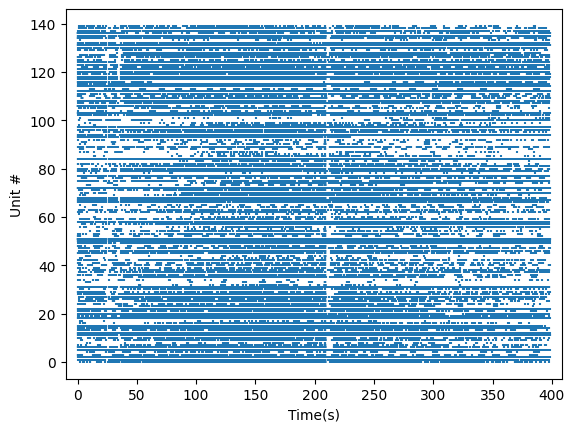

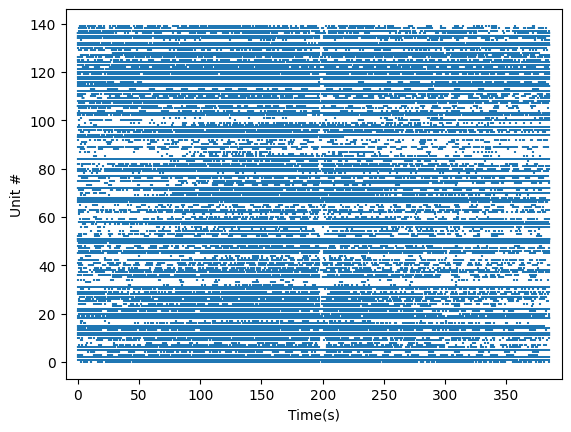

In [177]:
plot_raster(sd)
plot_raster(stitched_data)

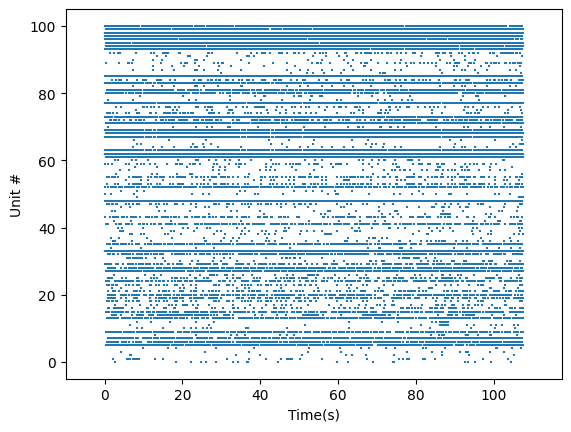

In [329]:
plot_raster(sdUnperNew)

### First Pass Analysis 

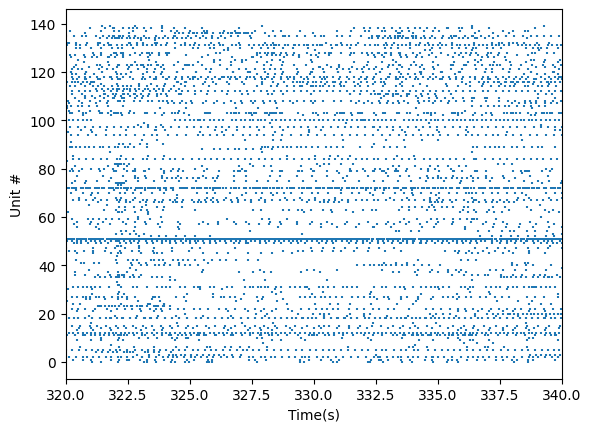

In [52]:
plot_raster(sd, l1=320, l2=340)

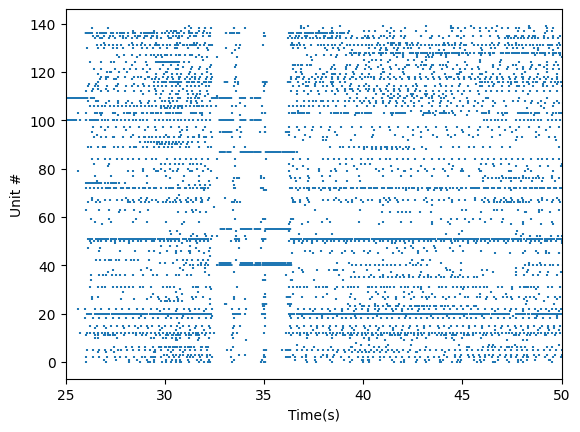

In [53]:
plot_raster(sd, l1=25, l2=50)

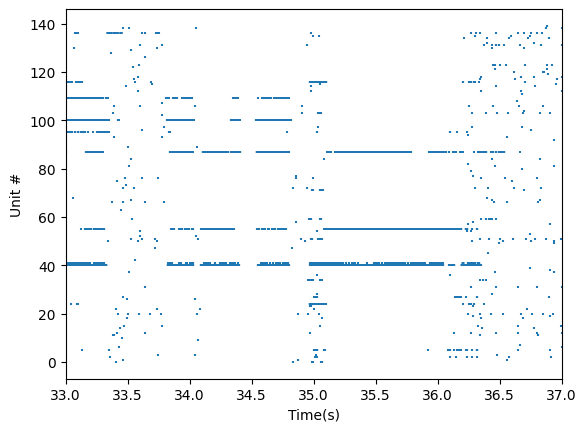

In [54]:
plot_raster(sd, l1=33, l2=37)

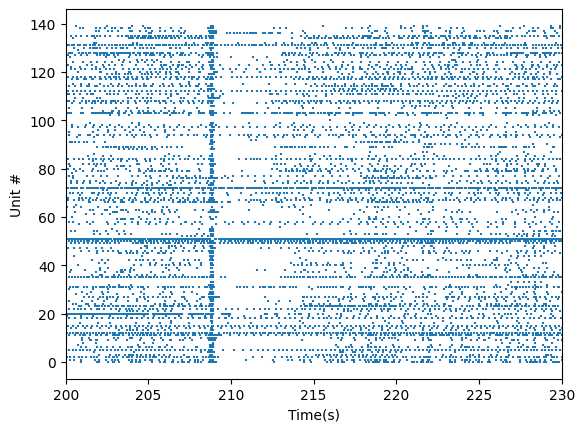

In [55]:
plot_raster(sd, l1=200, l2=230)

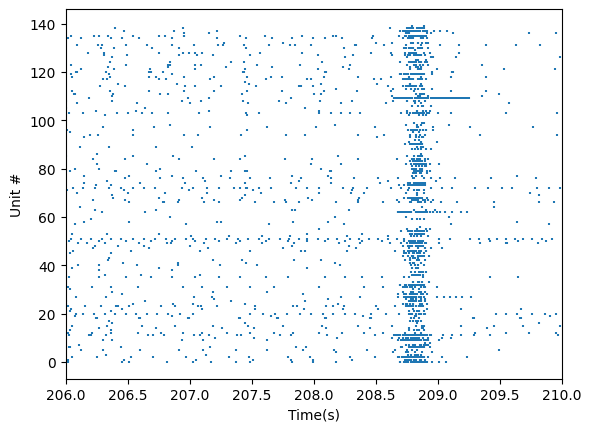

In [56]:
plot_raster(sd, l1=206, l2=210)

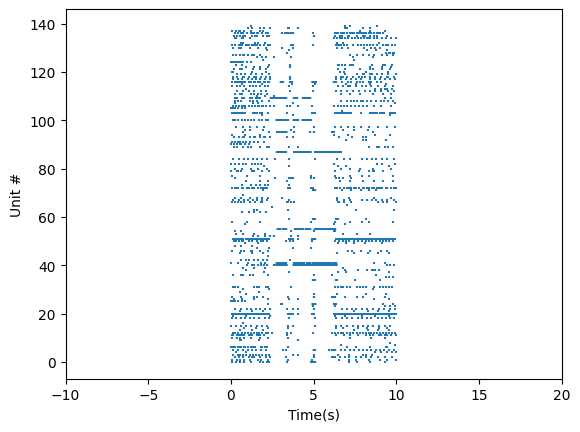

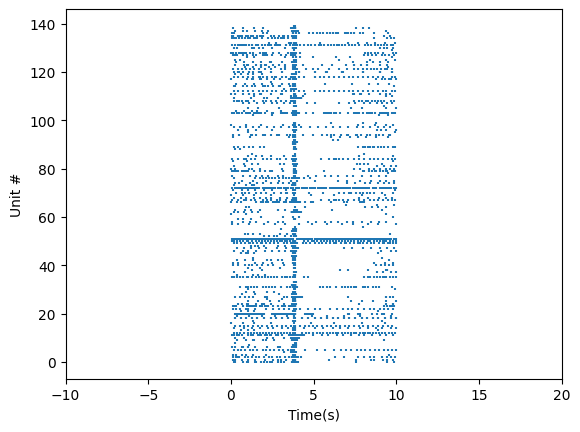

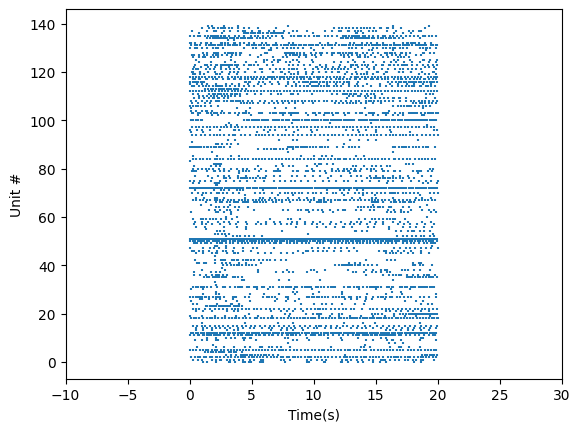

In [122]:
gap_sd = sd.subtime(30000, 40000)
burst_sd = sd.subtime(205000, 215000)
seg_sd = sd.subtime(320000, 340000)

plot_raster(gap_sd)
plot_raster(burst_sd)
plot_raster(seg_sd)

### Second Pass Analysis

#### Broad Searches

Segments that have already been looked at:
- gap: 30--40 
- burst: 205--215
- segment: 320--340

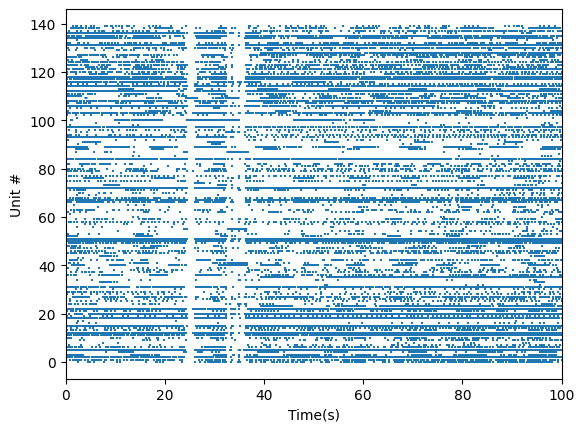

In [114]:
plot_raster(sd, l1=0, l2=100)

look at 20-30 for gap mirror

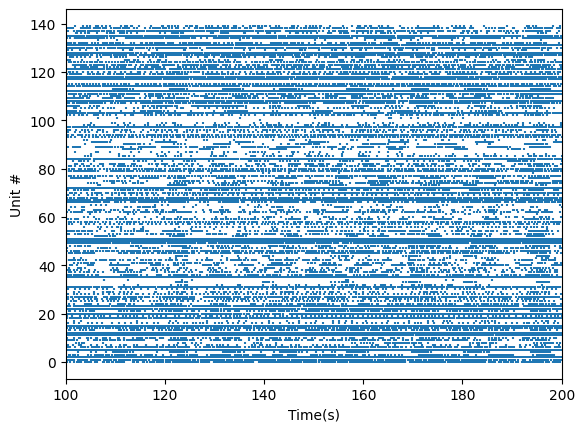

In [112]:
plot_raster(sd, l1=100, l2=200)

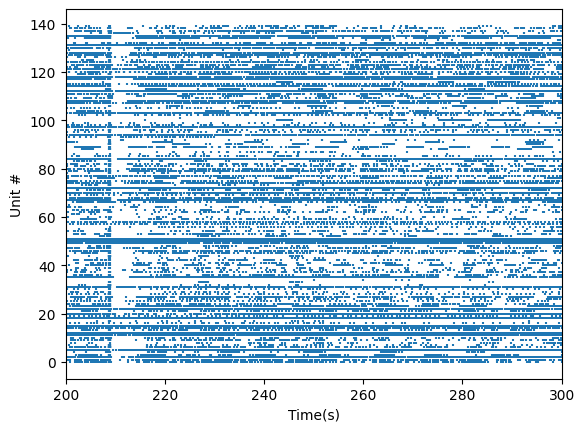

In [115]:
plot_raster(sd, l1=200, l2=300)

look at 230-240 for burst mirror?

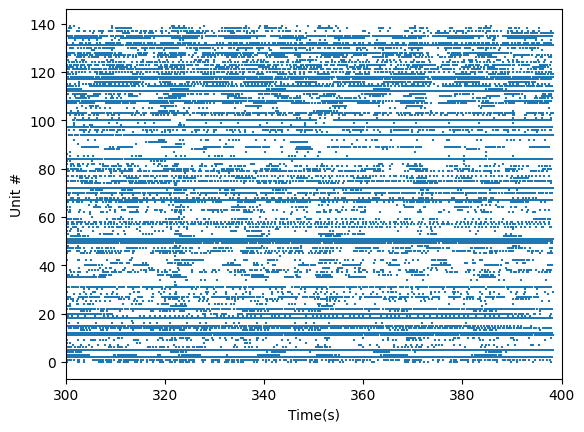

In [116]:
plot_raster(sd, l1=300, l2=400)

look at 350-360 for segment mirror

#### Narrowing

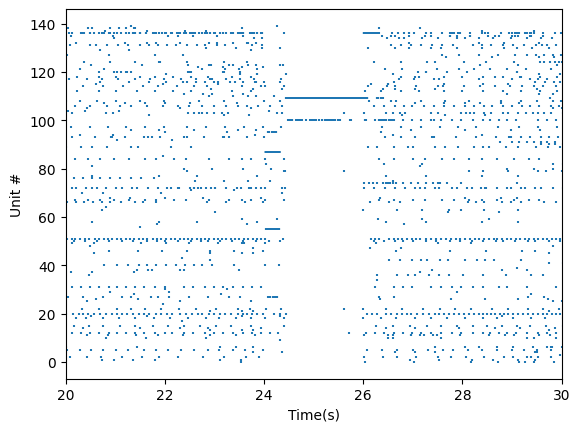

In [119]:
plot_raster(sd, l1=20, l2=30)

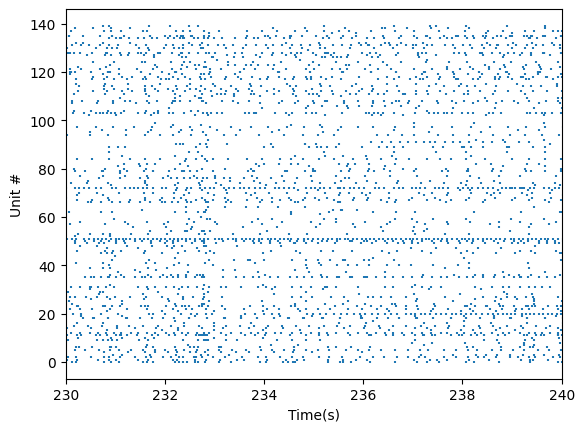

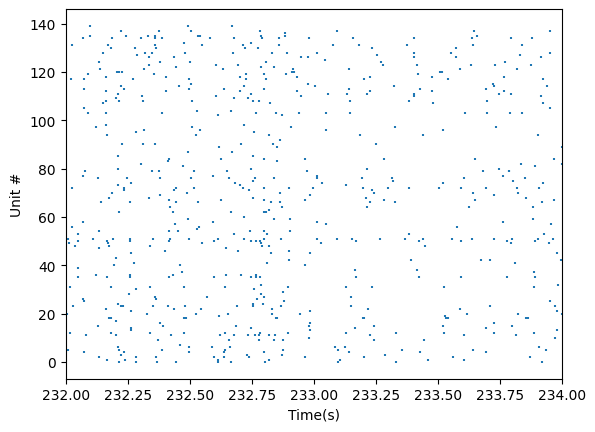

In [120]:
plot_raster(sd, l1=230, l2=240)
plot_raster(sd, l1=232, l2=234)

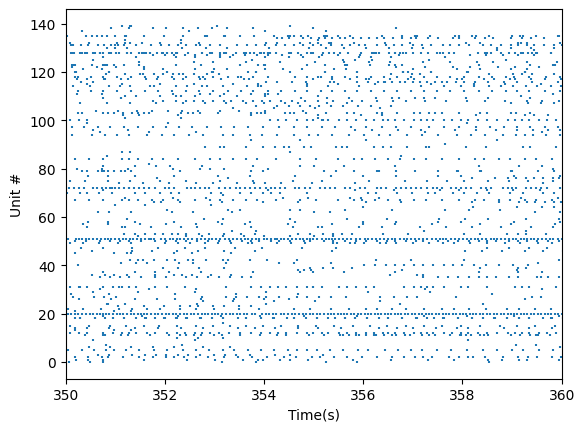

In [117]:
plot_raster(sd, l1=350, l2=360)

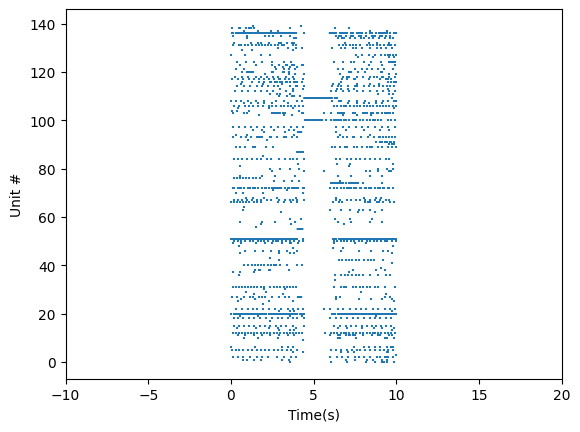

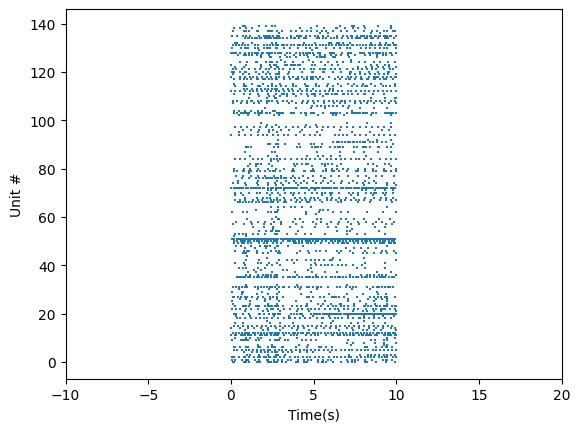

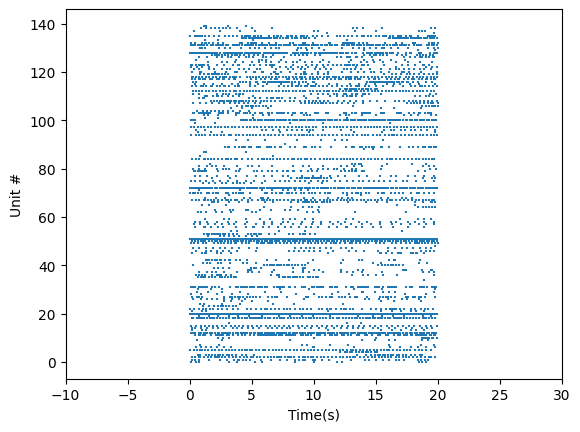

In [130]:
gap_mir = sd.subtime(20000, 30000)
burst_mir = sd.subtime(230000, 240000)
seg_mir = sd.subtime(350000, 370000)

plot_raster(gap_mir)
plot_raster(burst_mir)
plot_raster(seg_mir)

### Further Look

#### Firing Rates First Pass:

/tmp/ipykernel_642215/299562516.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in stitched_data.neuron_data[0].values():


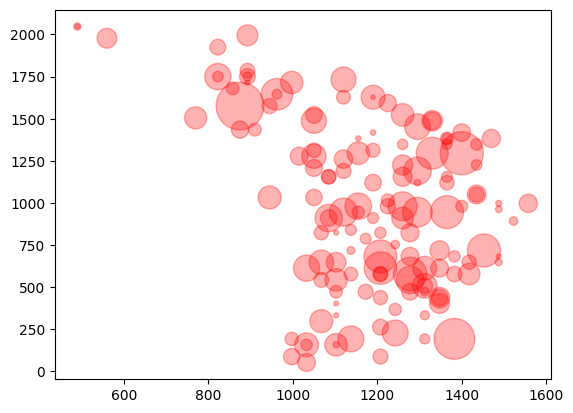

In [182]:
neuron_x = []
neuron_y = []
    
for neuron in stitched_data.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(stitched_data)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/1454649436.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in sd.neuron_data[0].values():


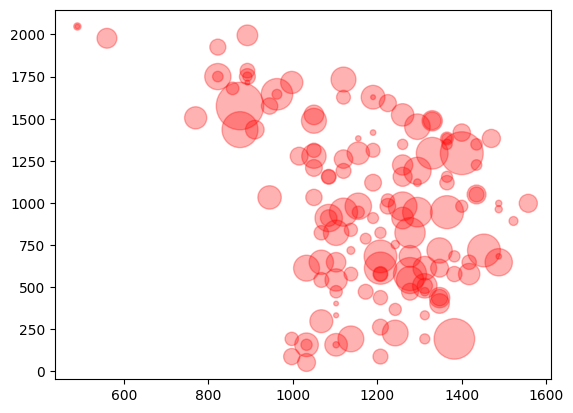

In [58]:
neuron_x = []
neuron_y = []
    
for neuron in sd.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(sd)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/3350263136.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in seg_sd.neuron_data[0].values():


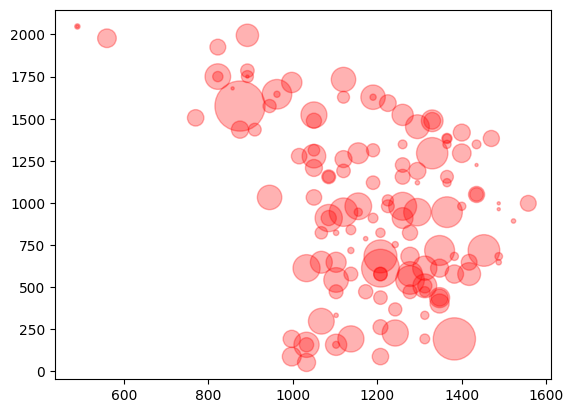

In [59]:
neuron_x = []
neuron_y = []
    
for neuron in seg_sd.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(seg_sd)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/1348449691.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in gap_sd.neuron_data[0].values():


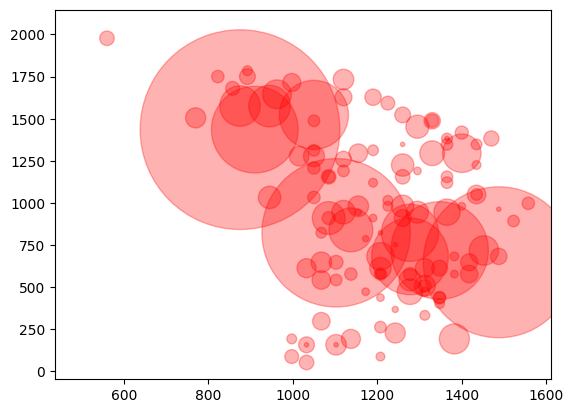

In [60]:
neuron_x = []
neuron_y = []
    
for neuron in gap_sd.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(gap_sd)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/2127992277.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in burst_sd.neuron_data[0].values():


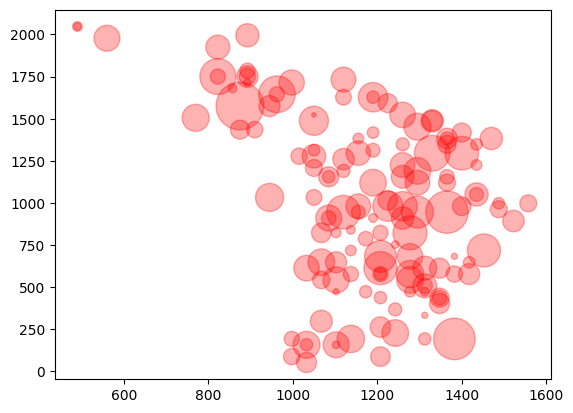

In [61]:
neuron_x = []
neuron_y = []
    
for neuron in burst_sd.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(burst_sd)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

#### Firing Rates Second Pass:

/tmp/ipykernel_642215/4009721995.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in gap_mir.neuron_data[0].values():


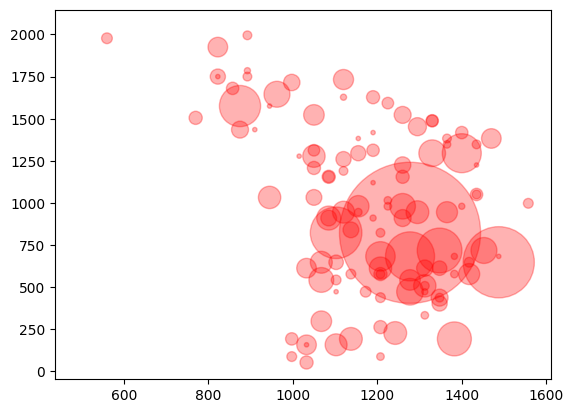

In [131]:
neuron_x = []
neuron_y = []
    
for neuron in gap_mir.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(gap_mir)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/2378122309.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in burst_mir.neuron_data[0].values():


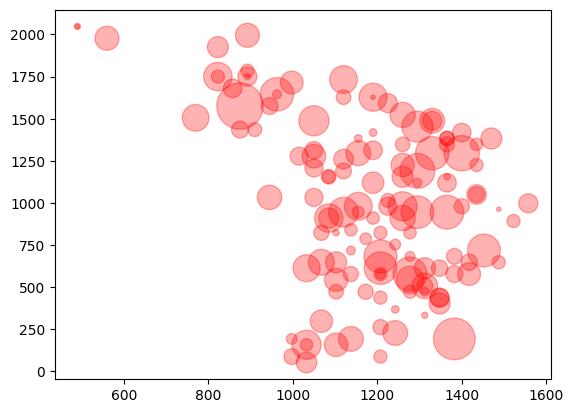

In [132]:
neuron_x = []
neuron_y = []
    
for neuron in burst_mir.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(burst_mir)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

/tmp/ipykernel_642215/2718771279.py:4: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in seg_mir.neuron_data[0].values():


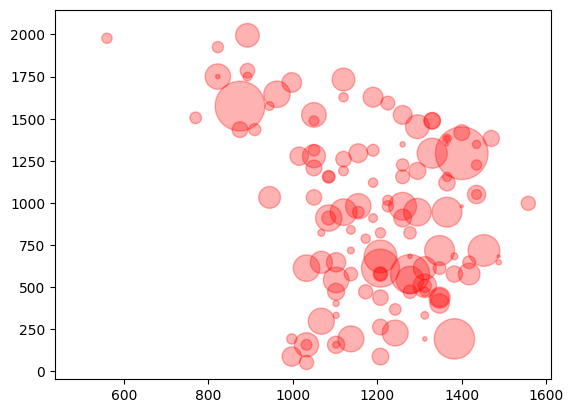

In [133]:
neuron_x = []
neuron_y = []
    
for neuron in seg_mir.neuron_data[0].values():
    neuron_x.append(neuron["position"][0])
    neuron_y.append(neuron["position"][1])
        
firing_rates = calculate_mean_firing_rates(seg_mir)
plt.scatter(neuron_x, neuron_y, s=firing_rates*100, c="red", alpha=0.3)

#### Eigen stuff

In [134]:
def get_eval_data(sd):
    global new_sd; global Corr; global STTC; global Toep; global Wcorr; global Ucorr; global Wsttc; global Usttc; global Wt; global Ut; # I couldn't be bothered to do it correctly 
    new_sd = sd
    Corr = correlation(sd)
    STTC = get_sttc(sd)
    Toep = toeplitz(Corr)

    Wcorr, Ucorr = eigenvalues_eigenvectors(Corr)
    Wsttc, Usttc = eigenvalues_eigenvectors(STTC)
    Wt, Ut = eigenvalues_eigenvectors(Toep)
    print("done!")

In [335]:
sds = {"Stitched Data":stitched_data,
       "Data":sd, 
       "Gap":gap_sd,
       "Burst":burst_sd,
       "Segment":seg_sd, 
       "Gap Mirror":gap_mir,
       "Burst Mirror":burst_mir, 
       "Segment Mirror":seg_mir
    }

In [340]:
interact_manual(get_eval_data, sd=sds) 

interactive(children=(Dropdown(description='sd', options={'Stitched Data': <braingeneers.analysis.analysis.Spi…

<function __main__.get_eval_data(sd)>

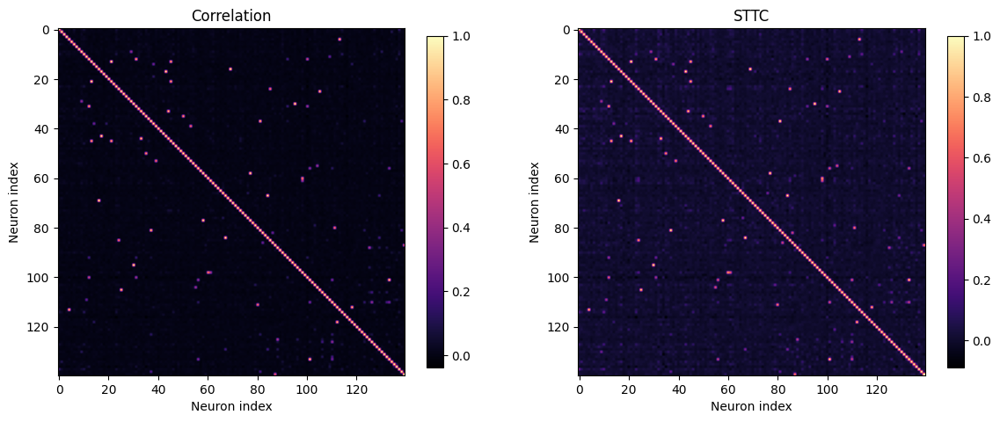

In [341]:
corrMethPlots(Corr, STTC)

/tmp/ipykernel_642215/2696923937.py:11: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  for neuron in sd.neuron_data[0].values(): # Plots neurons on a 2-d space, representing their positions on the array
/tmp/ipykernel_642215/2696923937.py:35: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  ix,iy = sd.neuron_data[0][i]['position']
/tmp/ipykernel_642215/2696923937.py:36: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  jx,jy = sd.neuron_data[0][j]['position']


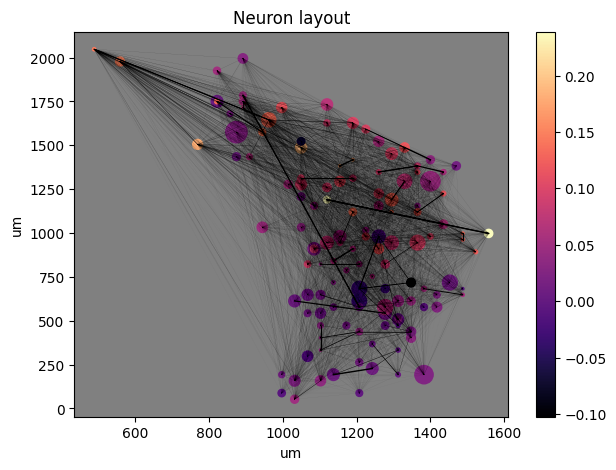

In [342]:
evectLayout(new_sd, Usttc[:,0], threshold=0)

/tmp/ipykernel_642215/3684913796.py:14: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  metadata=sd.metadata, neuron_data=sd.neuron_data,


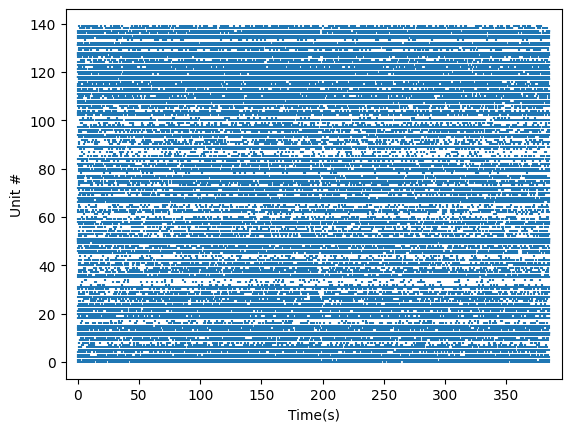

AttributeError: '_io.BufferedReader' object has no attribute 'split'

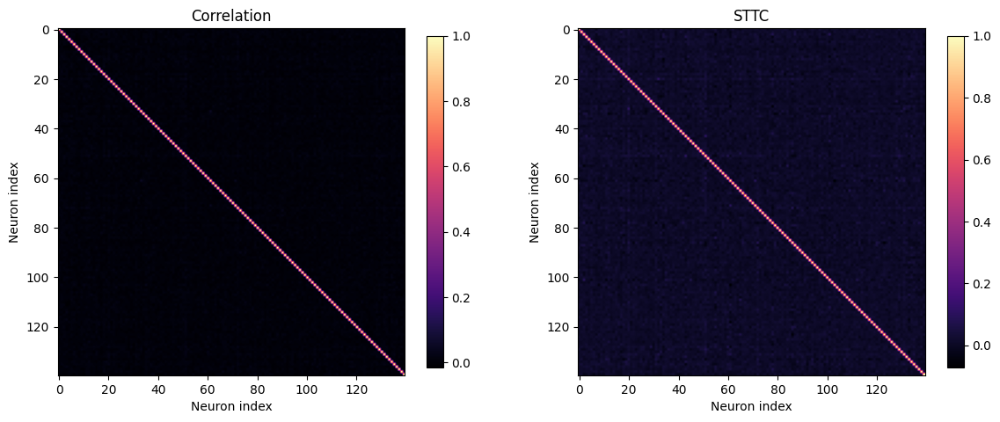

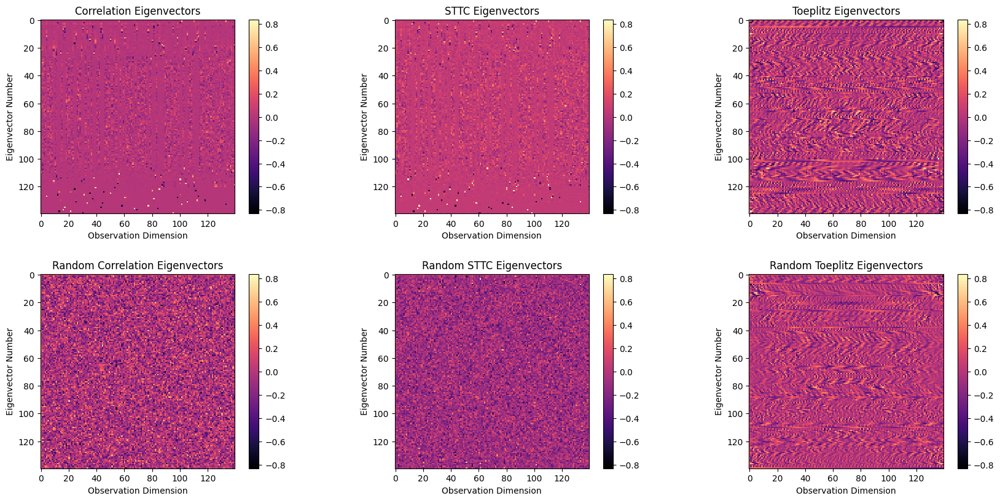

In [230]:
randomizedSD = KennethHarris(stitched_data, seed=0)

RCorr = correlation(randomizedSD)
RSTTC = get_sttc(randomizedSD)
RToep = toeplitz(RCorr)

RWcorr, RUcorr = eigenvalues_eigenvectors(RCorr)
RWsttc, RUsttc = eigenvalues_eigenvectors(RSTTC)
RWt, RUt = eigenvalues_eigenvectors(RToep)

methodRand = "KH"

plot_raster(randomizedSD)
corrMethPlots(RCorr, RSTTC)
randomPlots(Ucorr, Usttc, Ut, RUcorr, RUsttc, RUt, methodRand)

In [357]:
def randomComp(STTC1, randomSTTC):
    fig, plot = plt.subplot_mosaic("AB", figsize=(14,7)) 
    
    STTC2 = STTC1 - randomSTTC
    
    # Plot Correlation Matrix
    pltA = plot["A"].imshow(STTC1, cmap=plot_color) # plot STTC matrix
    plot["A"].set_title("Original STTC")
    plot["A"].set_xlabel("Neuron index")
    plot["A"].set_ylabel("Neuron index" )
    fig.colorbar(pltA, ax=plot["A"], shrink=0.7)

    # Plot STTC matrix
    pltB = plot["B"].imshow(STTC2, cmap=plot_color) # plot STTC matrix
    plot["B"].set_title("Random Subtraction STTC")
    plot["B"].set_xlabel("Neuron index")
    plot["B"].set_ylabel("Neuron index" )
    fig.colorbar(pltB, ax=plot["B"], shrink=0.7)

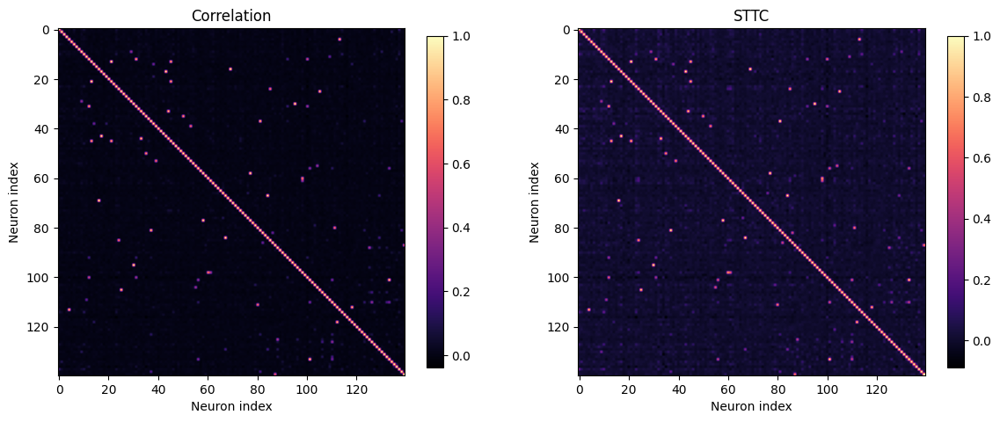

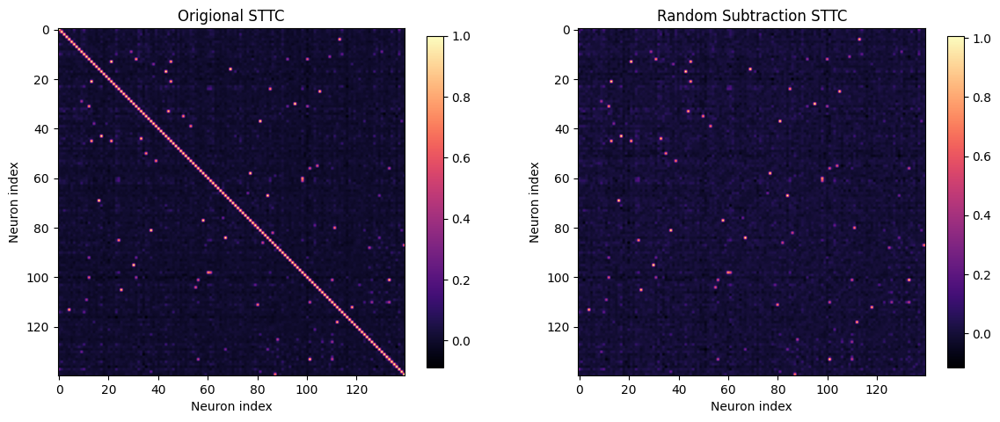

In [244]:
corrMethPlots(Corr, STTC)
randomComp(STTC, RSTTC)

In [358]:
def SubtractionIteration(sd, seedMain, iters, randmeth, triagemeth):
    randoms = []
    np.random.seed(seedMain)
    seeds = [np.random.randint(0, 1000000000) for _ in range(iters)]
    
    print("randomizing...")
    
    for i in range(iters):
        cur = seeds[i]
        print(f"running {cur}, {iters-1-i} left...")
        if randmeth =="Rotation":
            randobj = random_rotation(sd, seedIn=cur)
        elif randmeth =="Shuffle":
            randobj = random_shuffle(sd, seedIn=cur)
        else:
            randobj = KennethHarris(sd, dt=1.0, seed=cur)
        randomizedSTTC = get_sttc(randobj)
        np.fill_diagonal(randomizedSTTC, 0)
        randoms.append(randomizedSTTC)
    
    print("Done Randomizing")
    
    snapshot = datetime.now(Timezone)
    current_time = snapshot.strftime("%Y-%m-%d_%H-%M-%S")
    file_path = f'/home/jovyan/work/Human_Hippocampus/Ari/Pickled_Randomizations/PickledRands_seed-{seedMain}_{randmeth}_{current_time}.pkl'
    
    # comment this in if you want to save the random sttc data for later:
    """with open(file_path, 'wb') as file:
        pickle.dump(randoms, file)"""
    
    if triagemeth=="mean":
        RSTTC = np.mean( np.array(randoms), axis=0 )
    else: 
        RSTTC = np.median( np.array(randoms), axis=0 )
    
    sd_STTC = get_sttc(sd)
    np.fill_diagonal(sd_STTC, 0)
    randomComp(sd_STTC, RSTTC)
            

randomizing...
running 983753115, 9 left...


/tmp/ipykernel_642215/3684913796.py:14: DeprecationWarning: Call to deprecated function (or staticmethod) neuron_data. (Use NeuronAttributes instead of neuron_data, with the function load_spike_data())
  metadata=sd.metadata, neuron_data=sd.neuron_data,


running 330466754, 8 left...
running 475322977, 7 left...
running 320797825, 6 left...
running 977762205, 5 left...
running 663813506, 4 left...
running 483904526, 3 left...
running 78552195, 2 left...
running 462871392, 1 left...
running 201145147, 0 left...
Done Randomizing


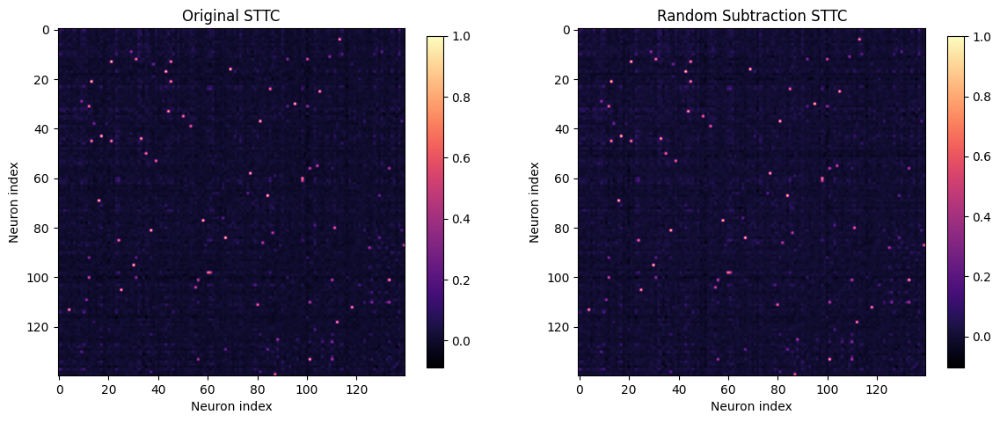

In [383]:
SubtractionIteration(new_sd, 5000, 10, "KH", "median")

In [ ]:
SubtractionIteration(stitched_data, 5000, 10, "KH", "median")


rotation saved for Elliott: 
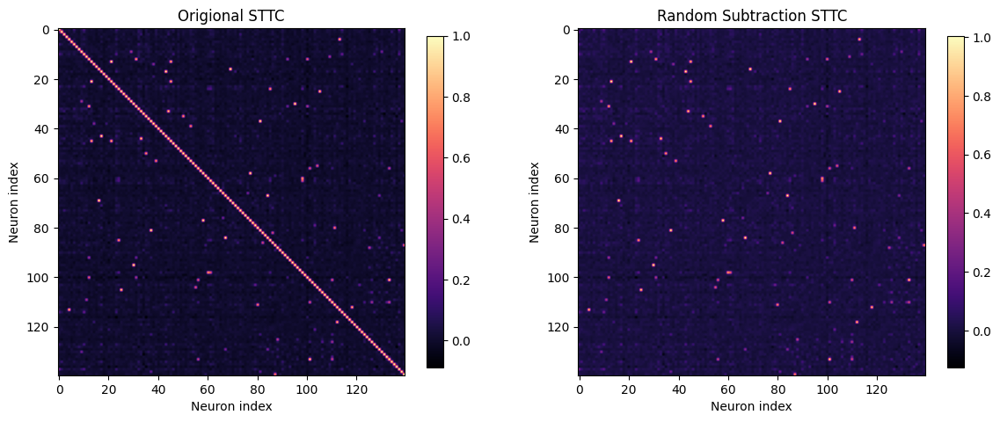

In [450]:
def print_pickled_rands(path): 
    # Settings
    bin_count1 = 60
    bin_count2 = 60
    
    use_lim = False
    OGxlim_start = -0.08
    OGxlim_end = 0.05
    OGmax = 31
    RDxlim_start = -0.08
    RDxlim_end = 0.05
    RDmax = 31
    
    
    # Open File
    file = open(path, 'rb')
    rands = pickle.load(file)
    file.close()
    
    # STTC Hist Comparison
    STTC = get_sttc(new_sd)
    np.fill_diagonal(STTC, 0)
    flatSTTC = STTC.flatten()
    
    RSTTC = rands[0]
    flatRSTTC = RSTTC.flatten()
    
    fig, plts = plt.subplot_mosaic("AB", figsize=(24,8))
    plts["A"].hist(flatSTTC, density=True, color="red", bins=bin_count1)
    if use_lim == True:
        plts["A"].set_xlim(OGxlim_start, OGxlim_end)
        plts["A"].set_ylim(0, OGmax)
    plts["A"].set_xlabel("STTC Value")
    plts["A"].set_ylabel("Density")
    plts["A"].set_title("Original STTC")
                            
    plts["B"].hist(flatRSTTC, density=True, bins=bin_count2)
    if use_lim == True:
        plts["B"].set_xlim(RDxlim_start, RDxlim_end)
        plts["B"].set_ylim(0, RDmax)
    plts["B"].set_xlabel("STTC Value")
    plts["B"].set_ylabel("Density")
    plts["B"].set_title("Randomized STTC")
    
    # Random STTCs matrices
    
    figs, axs = plt.subplots(nrows=2,ncols=int(len(rands)/2),figsize=(24,12))
    figs.suptitle(f"Plots of: {path}", ha="center")
    
    for i in range(len(rands)): 
        if i < len(rands)/2:
            plt_a = axs[0,i].imshow(rands[i], cmap=plot_color)
            axs[0,i].set_title(f"rand {i}")
            axs[0,i].set_ylabel("Neuron index" )
            axs[0,i].set_ylabel("Neuron index" )
            figs.colorbar(plt_a, ax=axs[0,i], shrink=0.7)
        else:
            plt_a = axs[1,int(i-(len(rands)/2))].imshow(rands[i], cmap=plot_color)
            axs[1,int(i-(len(rands)/2))].set_title(f"rand {i}")
            axs[1,int(i-(len(rands)/2))].set_ylabel("Neuron index" )
            axs[1,int(i-(len(rands)/2))].set_ylabel("Neuron index" )
            figs.colorbar(plt_a, ax=axs[1,int(i-(len(rands)/2))], shrink=0.7)

In [451]:
usepath = "/home/jovyan/work/Human_Hippocampus/Ari/Pickled_Randomizations/PickledRands_seed-5000_KH_2023-08-25_11-52-32.pkl"

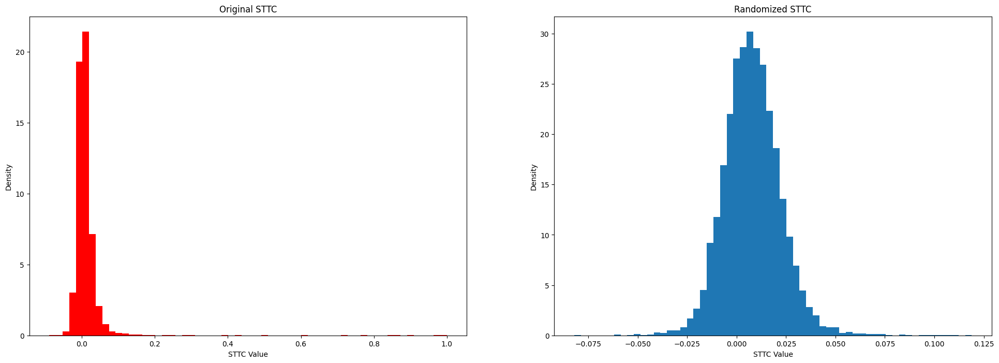

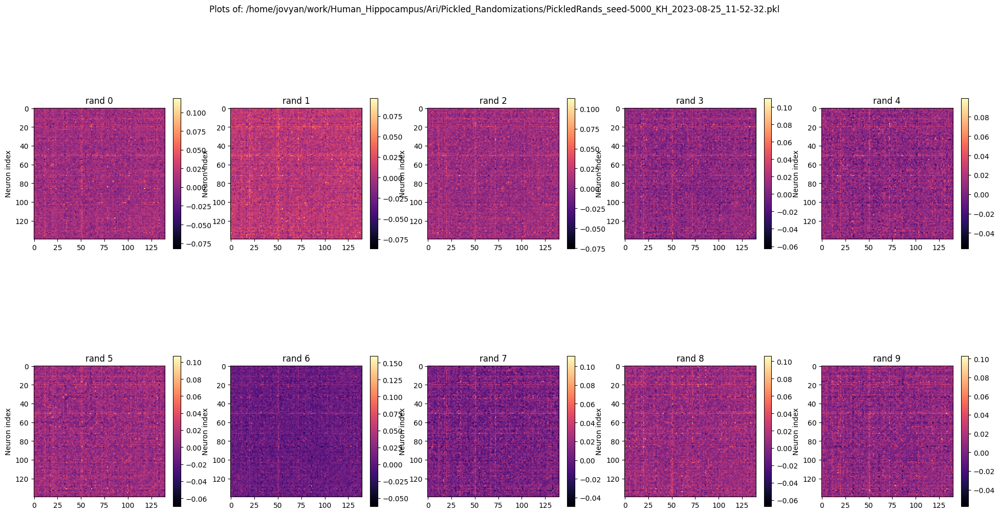

In [452]:
print_pickled_rands(usepath)

In [323]:
def basisOfStitch(A): 
    plt.figure(figsize=(6,8))
    for i in range(5):
        if i: plt.xticks([])
        plt.subplot(5, 1, i+1)
        plt.stem(A[:,i])
    plt.xlabel('Observation Dimension')
    plt.suptitle('First 5 Eigenvectors', y=0.92)    

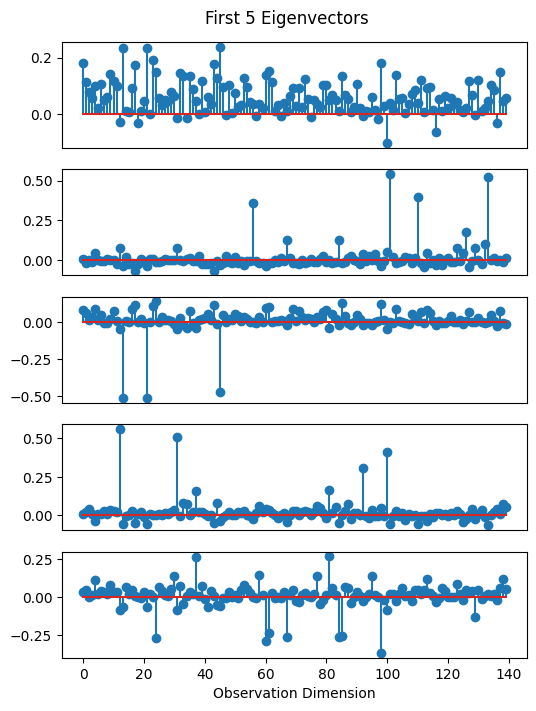

In [326]:
basisOfStitch(Usttc)

## <font color="green">DATA

### <font color="green">Normal

Raster segment:
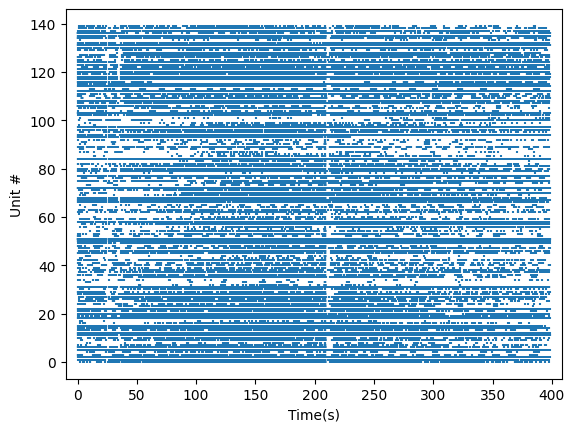

Firing rate plotted:
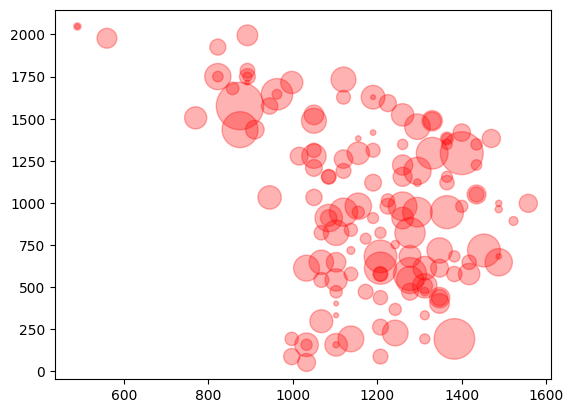

Normal corrs:

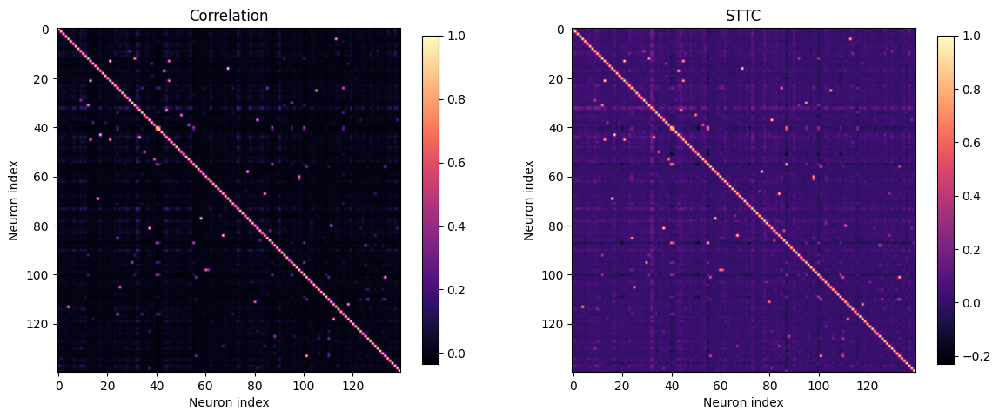

Threshold set to 1:
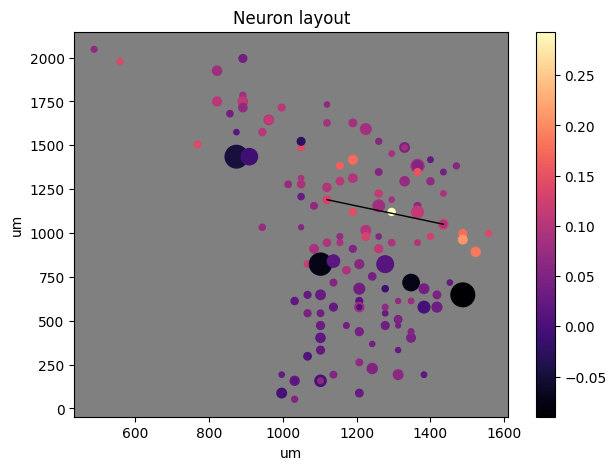


Threshold set to 0.9:
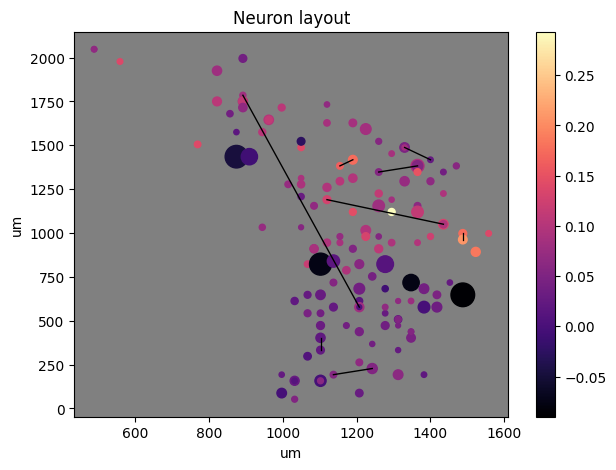


Threshold set to 0.75:
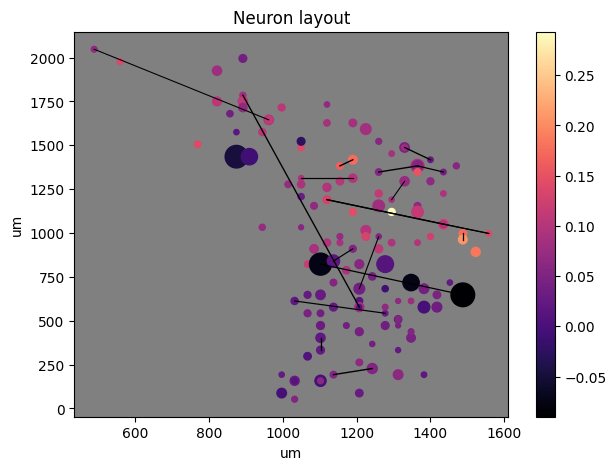


Threshold set to 0.5: 
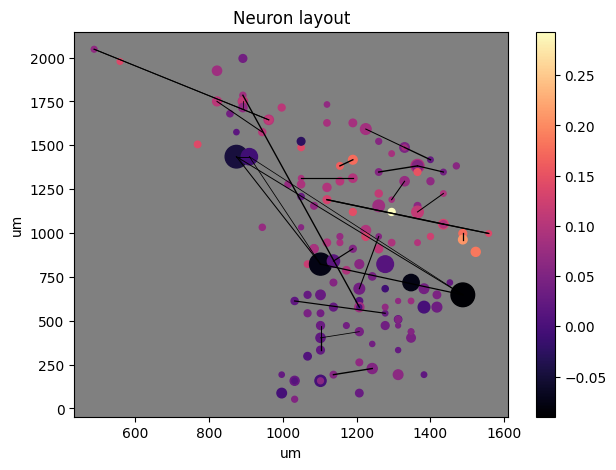


Threshold set to 0.25:
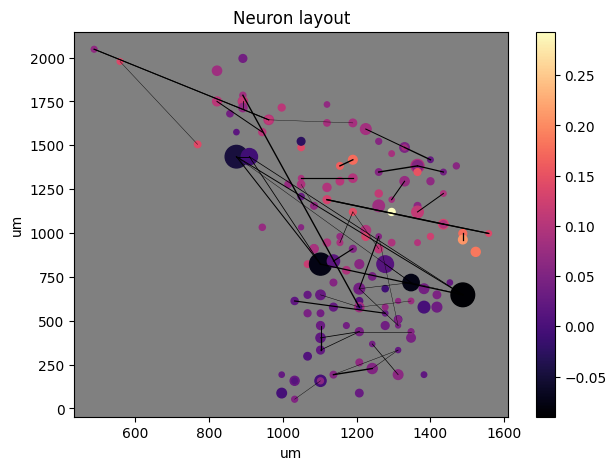


Threshold set to 0:
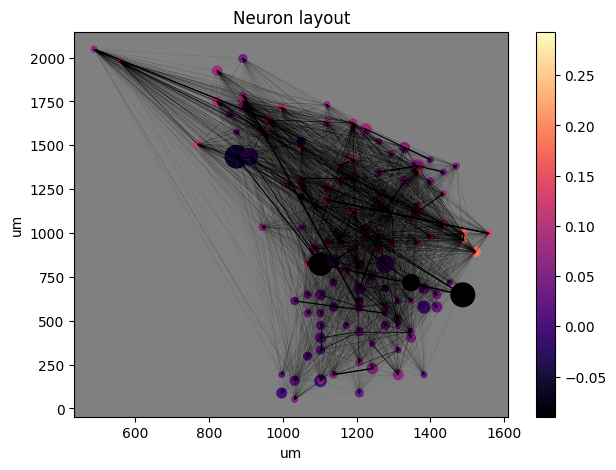

### <font color="blue">Original 3 Subsets

#### Gap (30-40)

Raster segment:
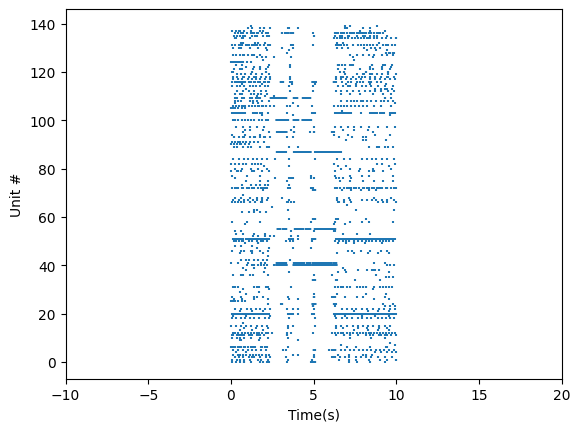


Firing rate plotted:
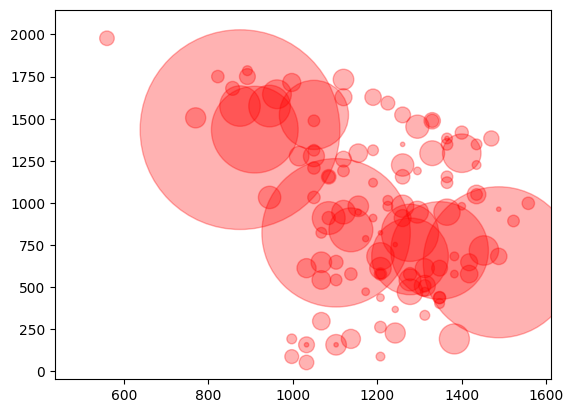

Gap corrs:

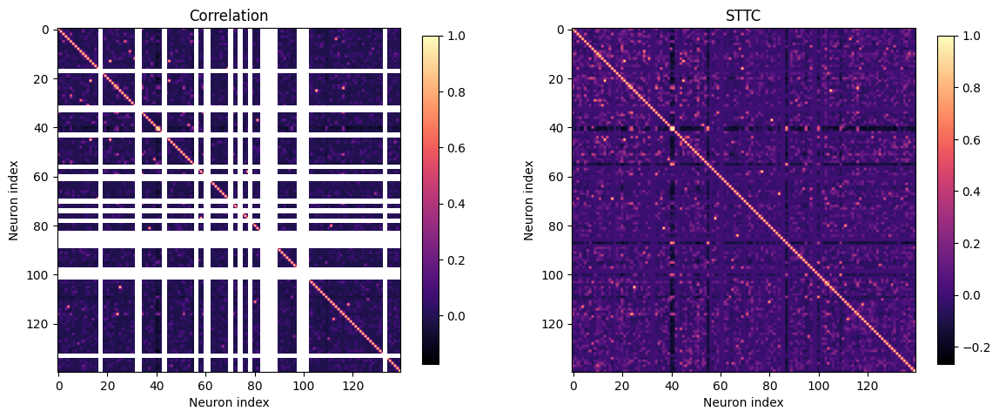

Threshold set to 1:
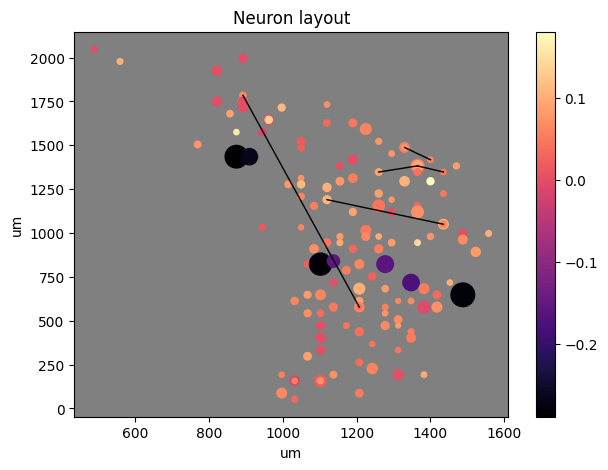

Threshold set to 0.9:
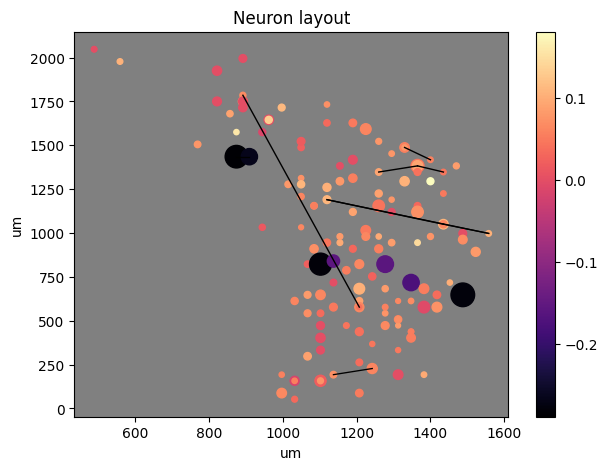

Threshold set to 0.75:
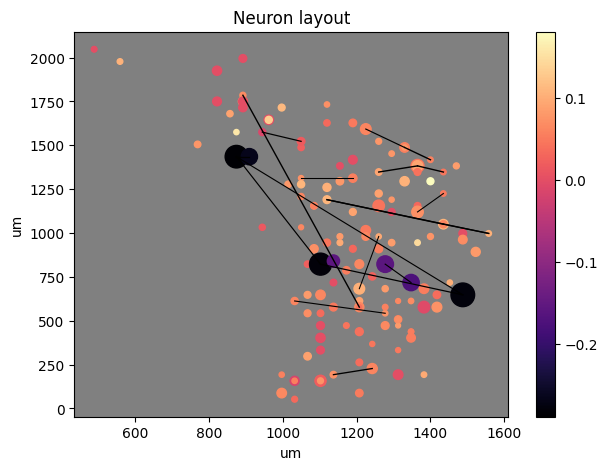

Threshold set to 0.5: 
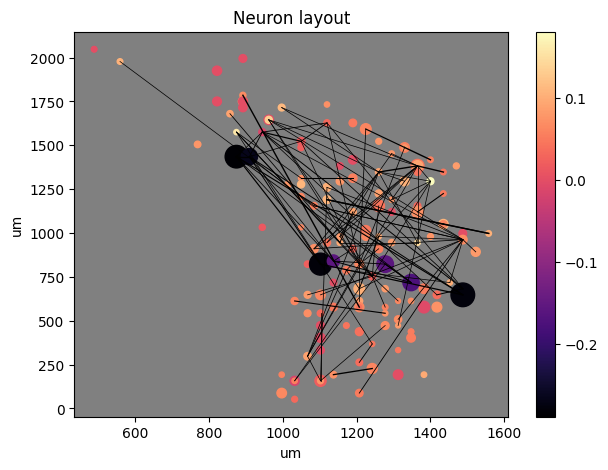

Threshold set to 0.25:
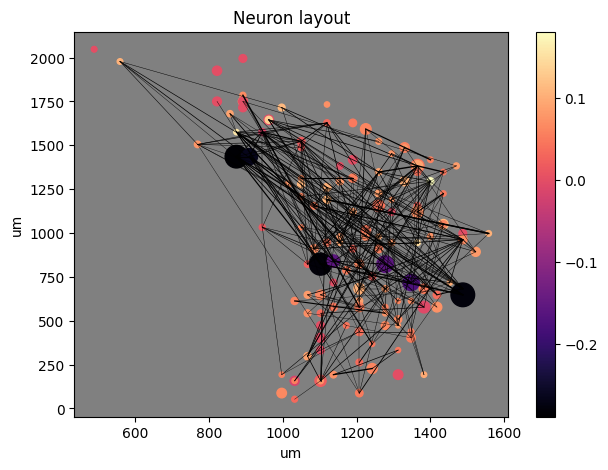

Threshold set to 0:
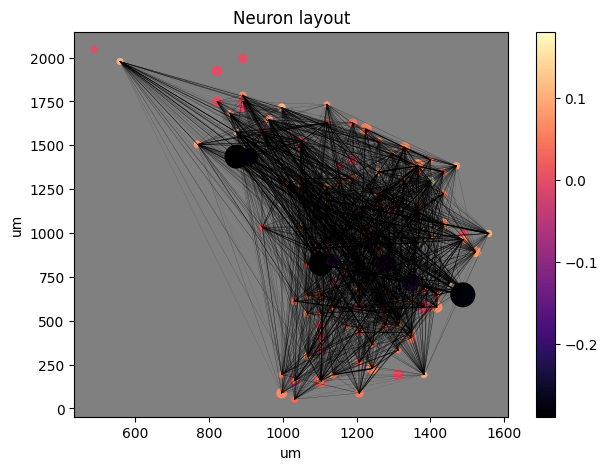

#### Burst (205-215)

Raster segment:
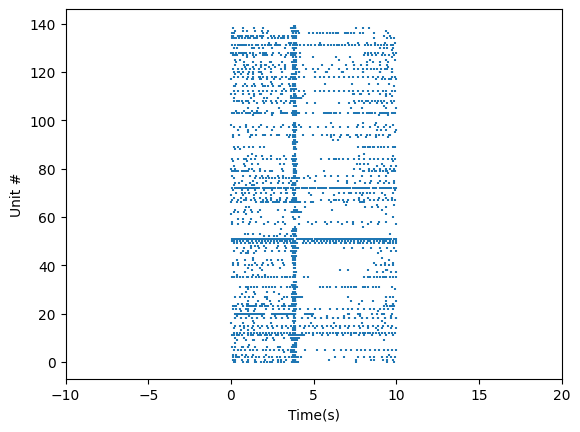


Firing rate plotted:
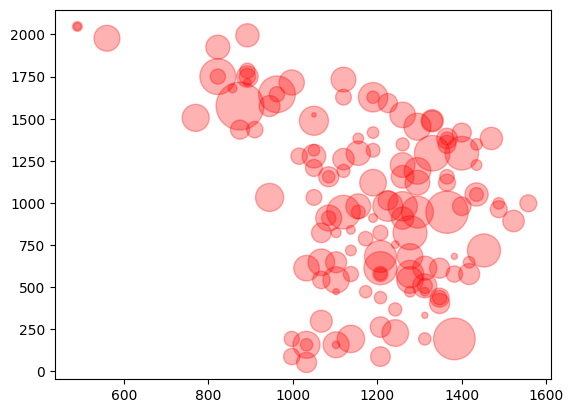

Burst corrs:

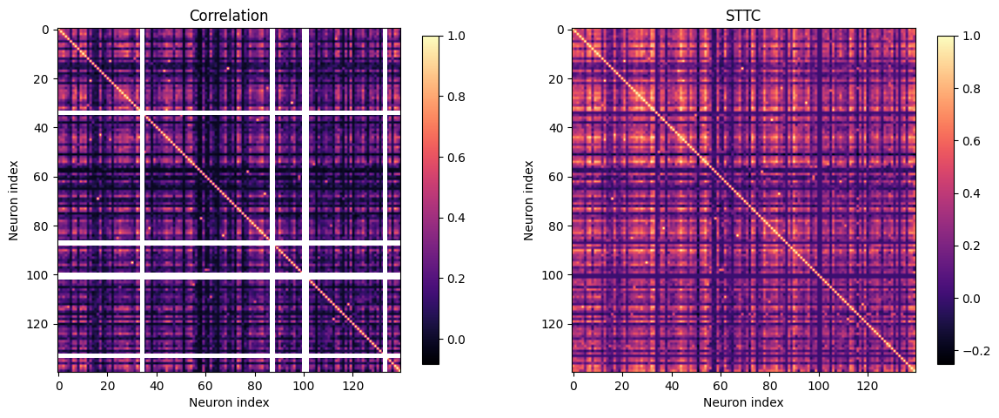

Threshold set to 1:
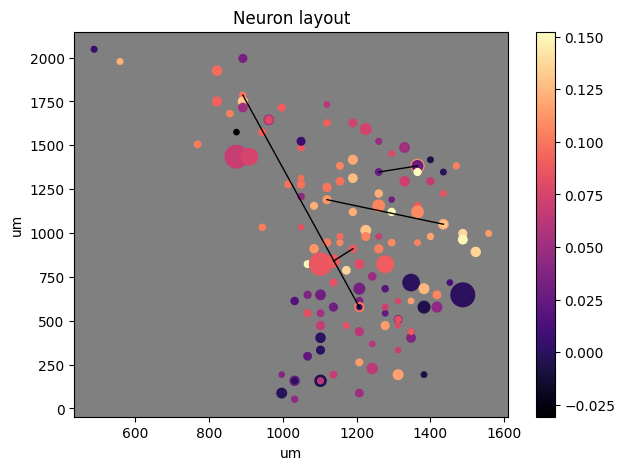


Threshold set to 0.9:
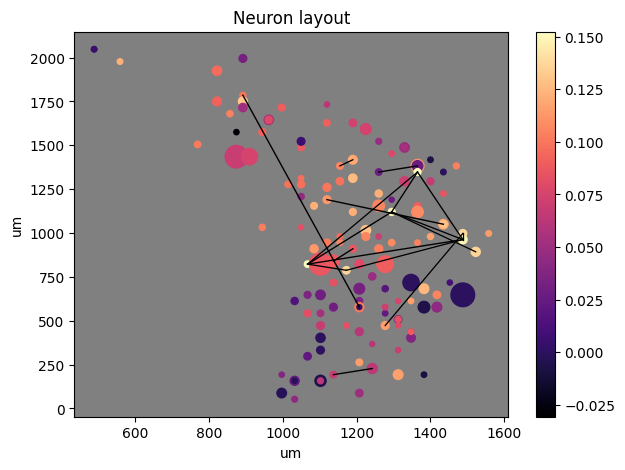


Threshold set to 0.75:
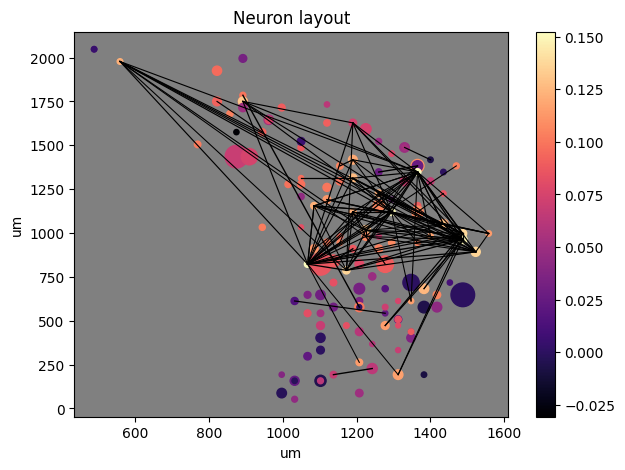


Threshold set to 0.5: 
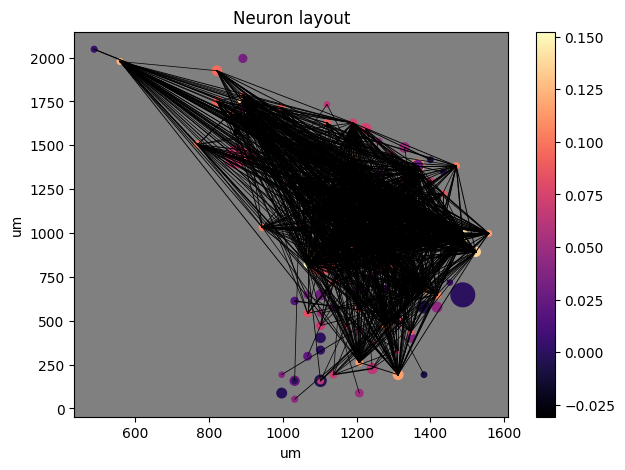


Threshold set to 0.25:
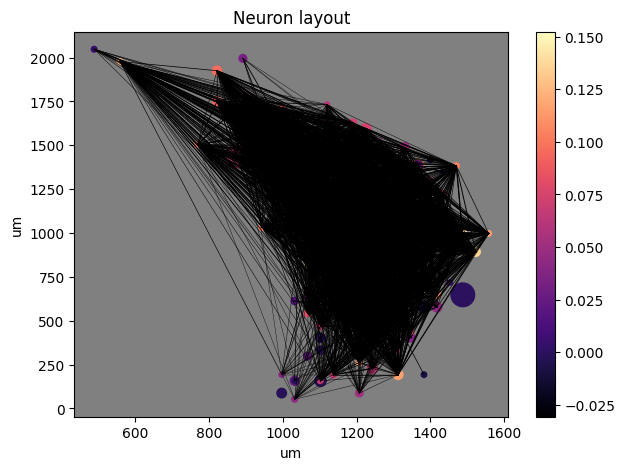


Threshold set to 0:
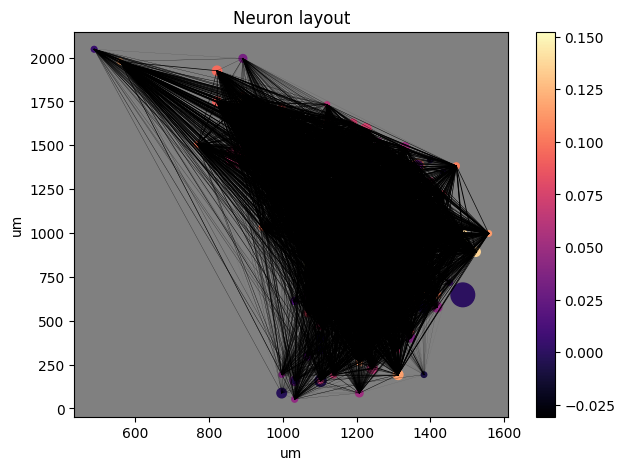

#### Segment (320-340)

Raster segment:
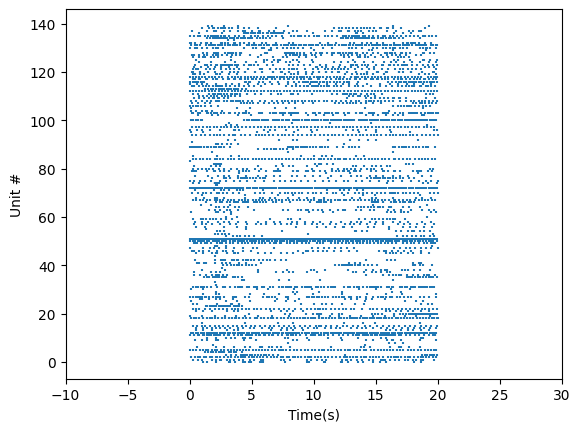


Firing rate plotted:
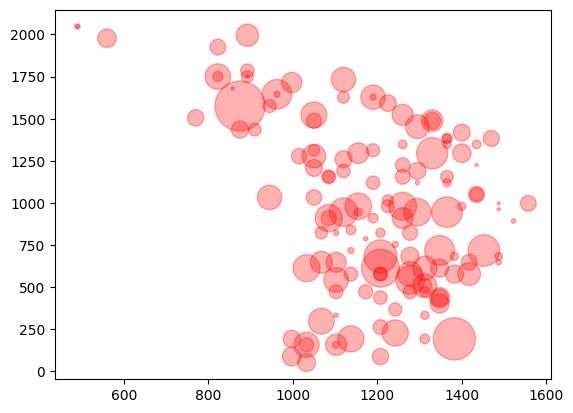

Seg corrs:

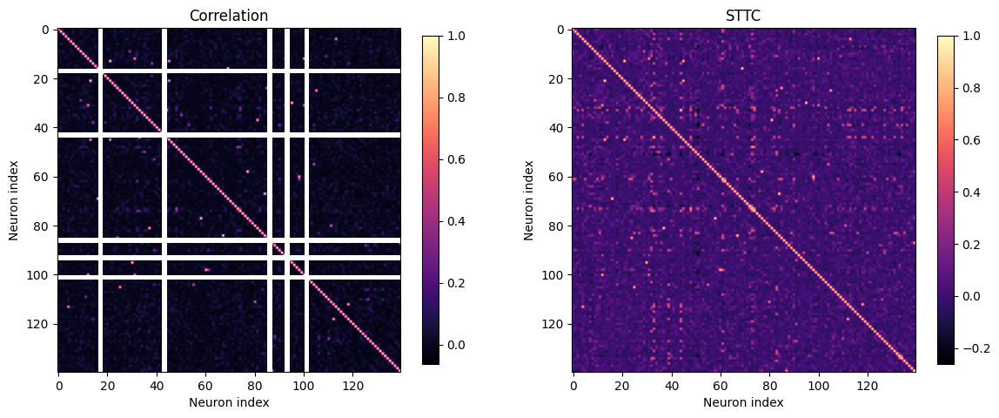

Threshold set to 1:
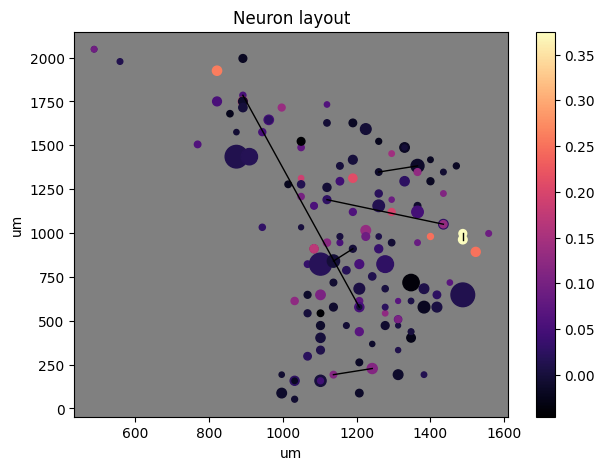


Threshold set to 0.9:
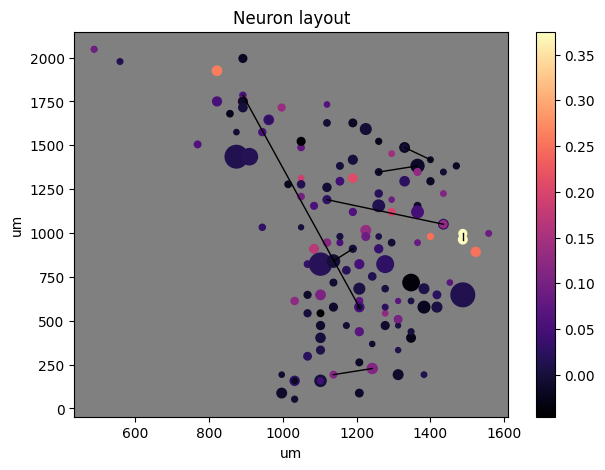


Threshold set to 0.75:
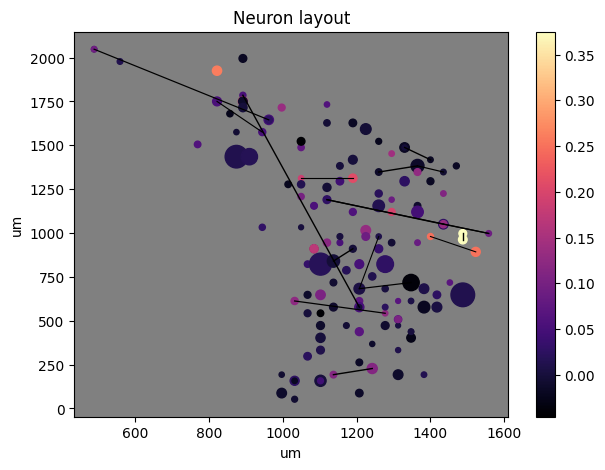


Threshold set to 0.5: 
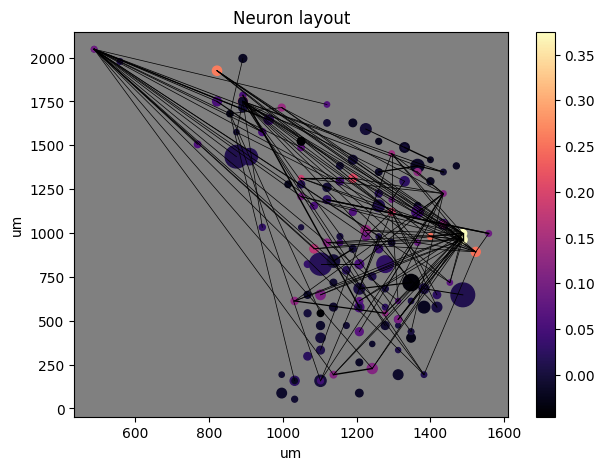


Threshold set to 0.25:
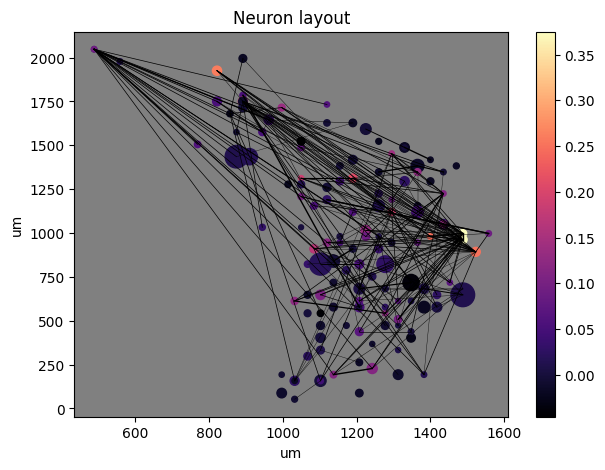


Threshold set to 0:
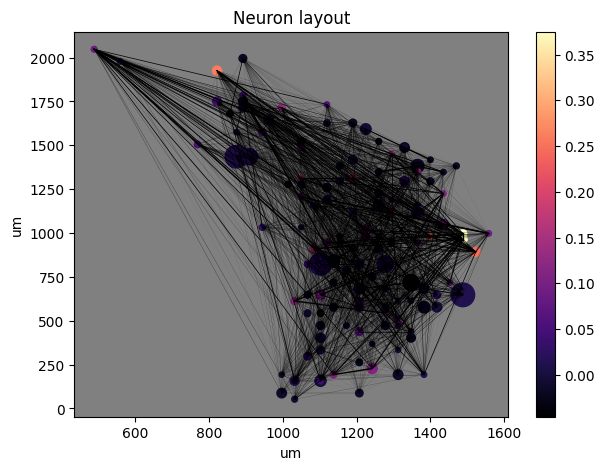

### <font color="brown">Follow-up Subsets

#### Gap Mirror (20-30)

Raster segment:
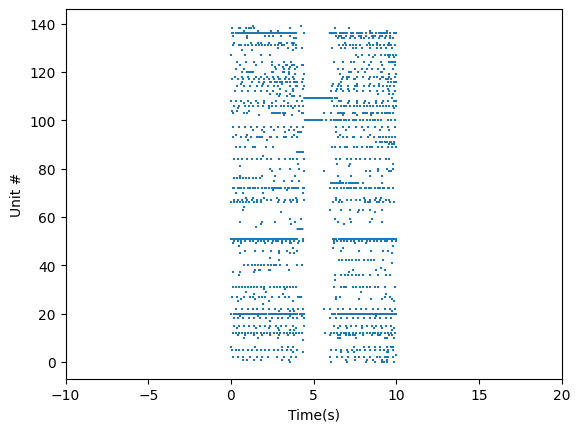


Firing rate plotted:
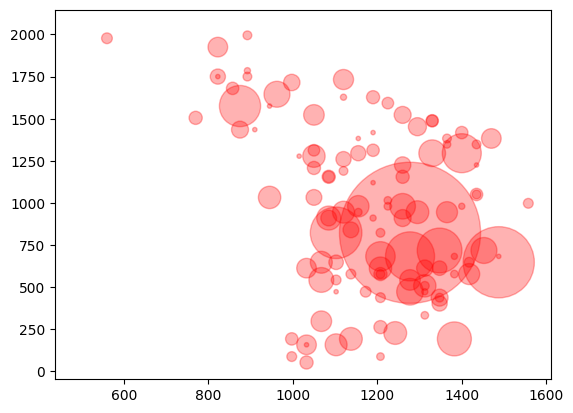

Corrs:

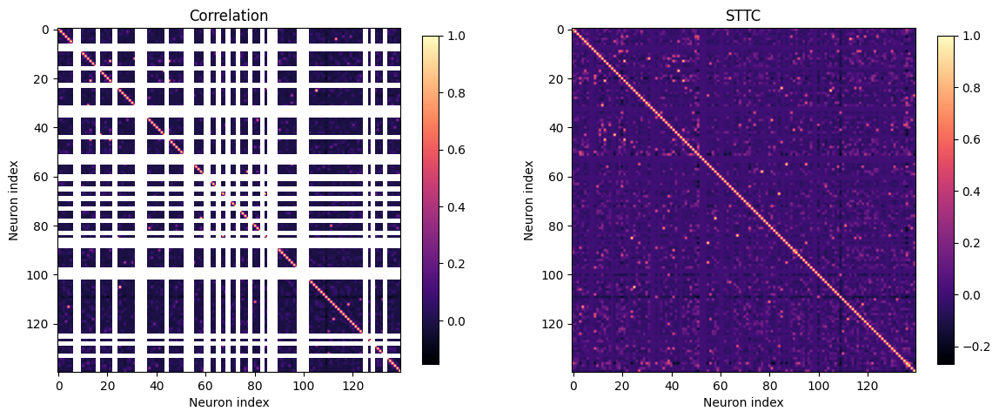

Threshold set to 1:
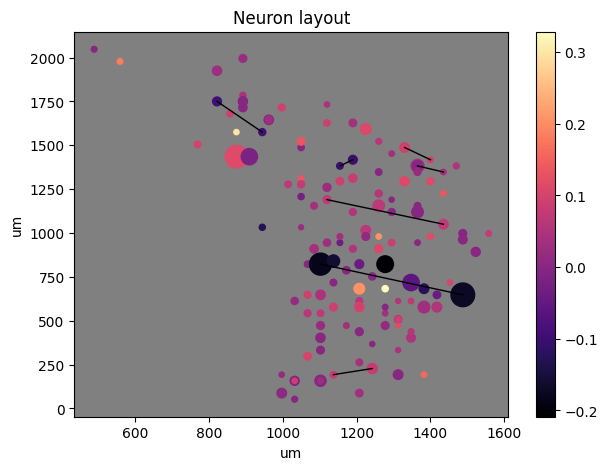


Threshold set to 0.9:
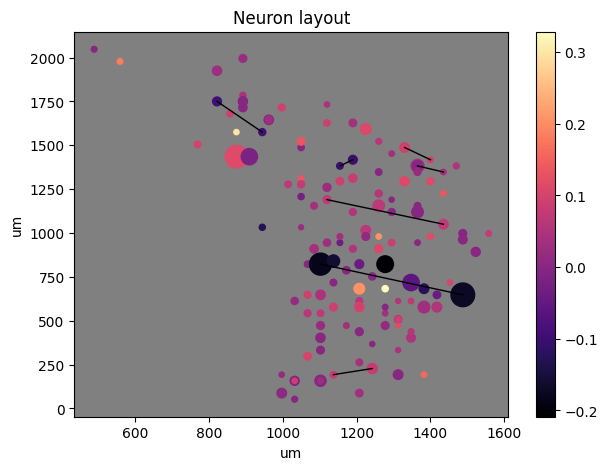


Threshold set to 0.75:
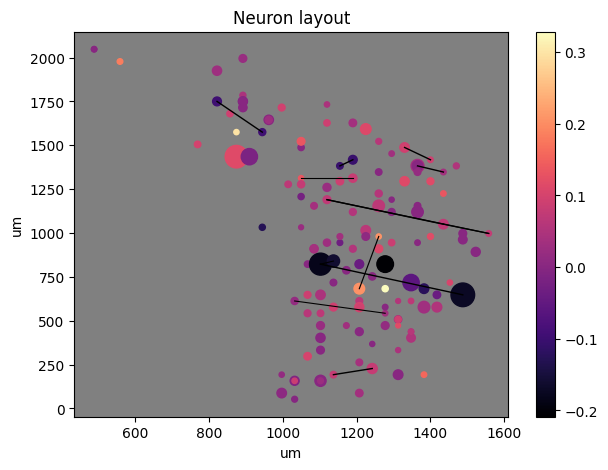


Threshold set to 0.5: 
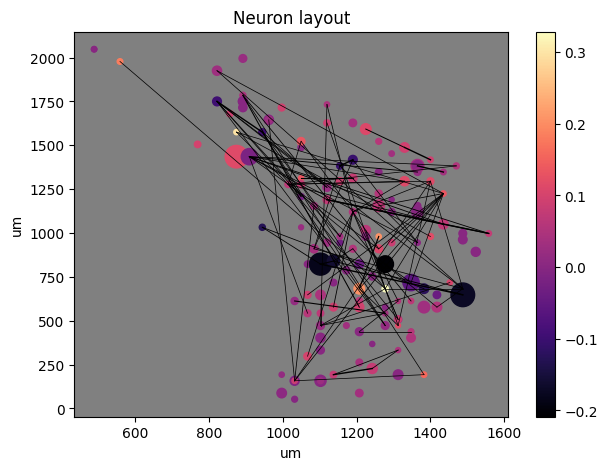


Threshold set to 0.25:
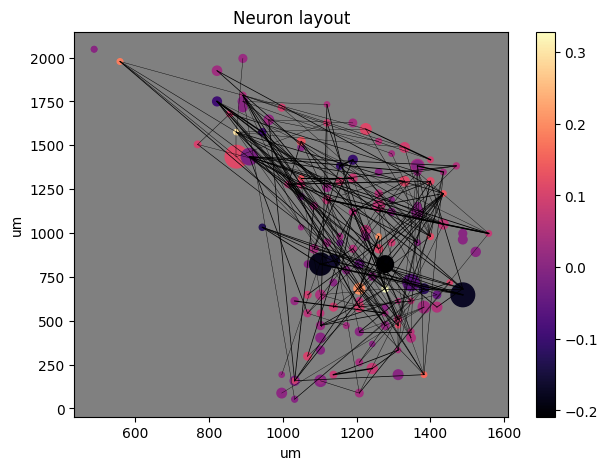


Threshold set to 0:
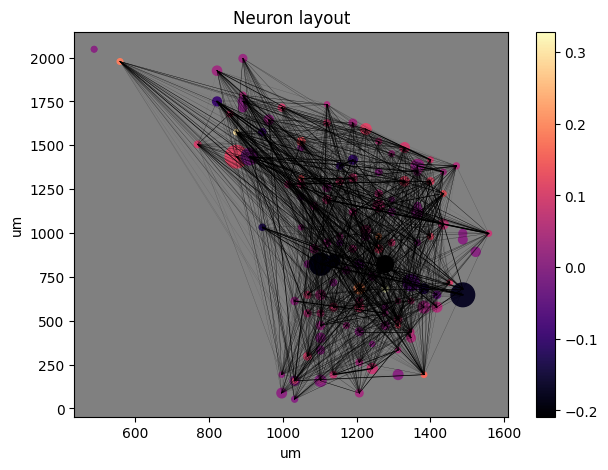

#### Burst Mirror (230-240)

Raster segment:
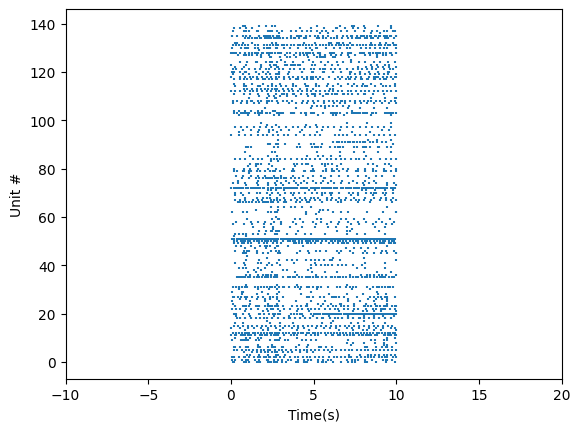


Firing rate plotted:
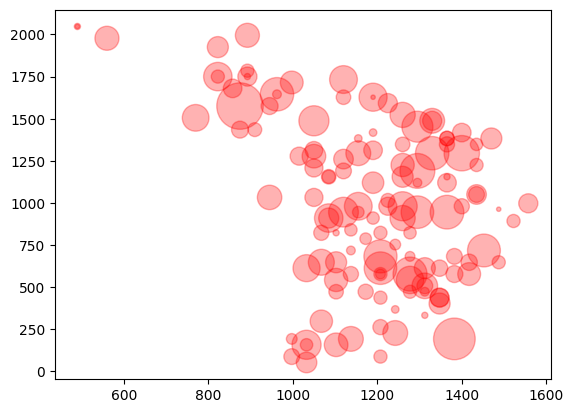

Corrs:

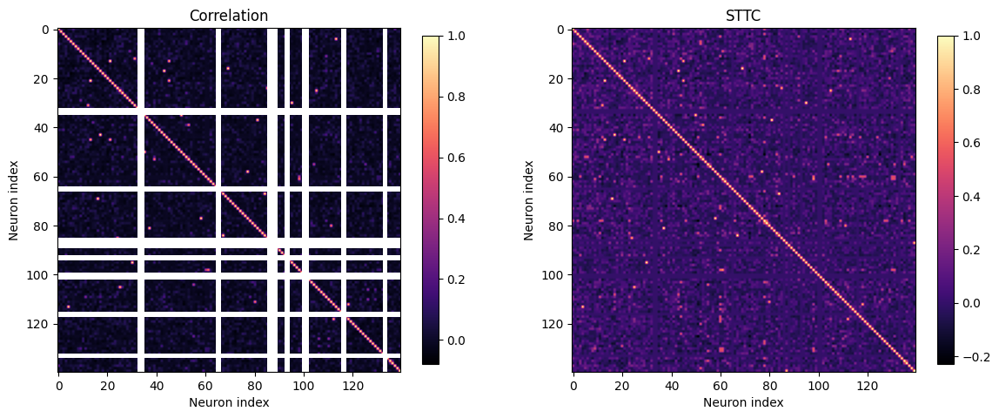

Threshold set to 1:
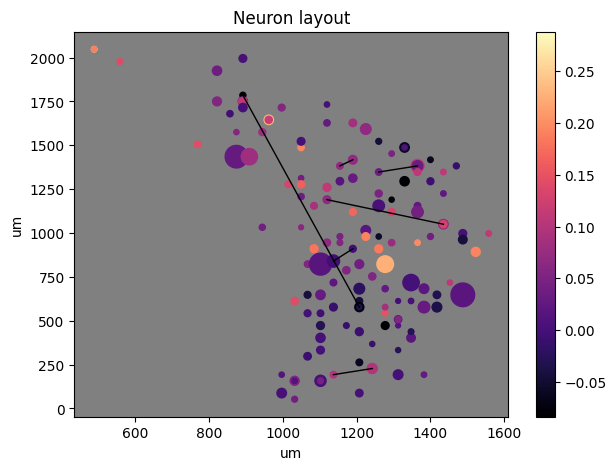


Threshold set to 0.9:
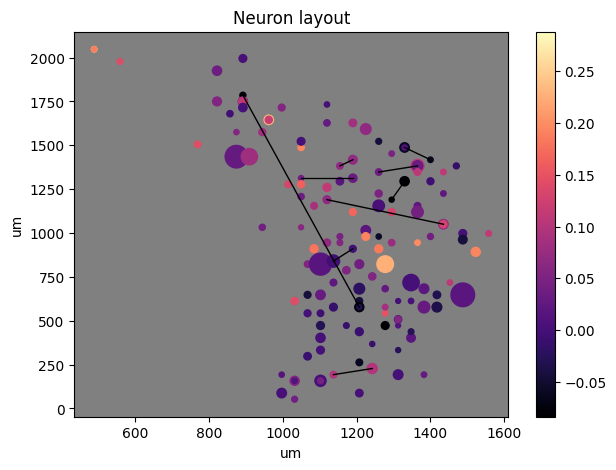


Threshold set to 0.75:
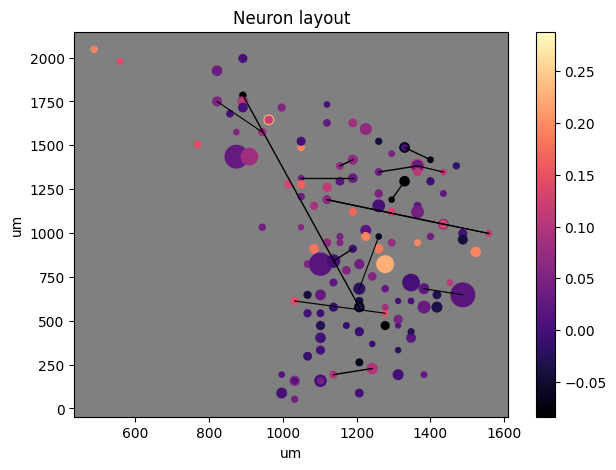


Threshold set to 0.5: 
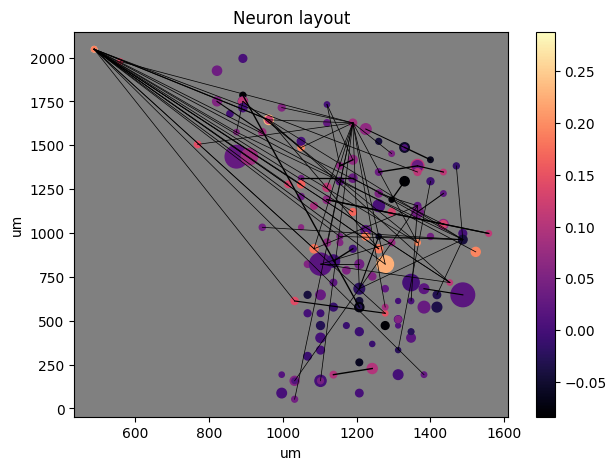


Threshold set to 0.25:
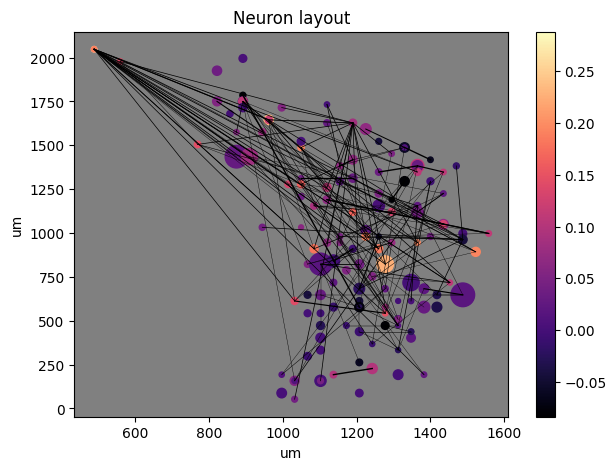


Threshold set to 0:
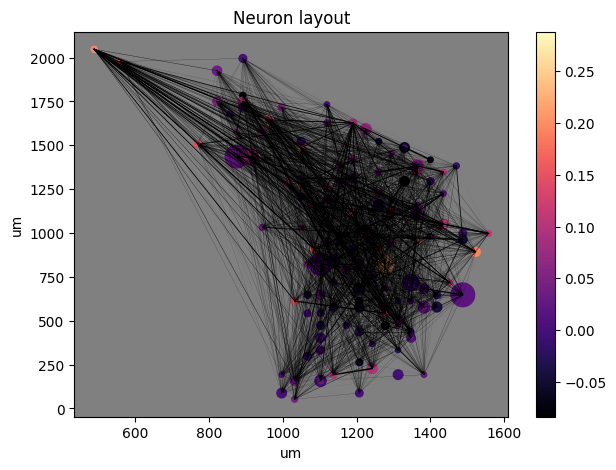

#### Segment Mirror (350-370)

Raster segment:
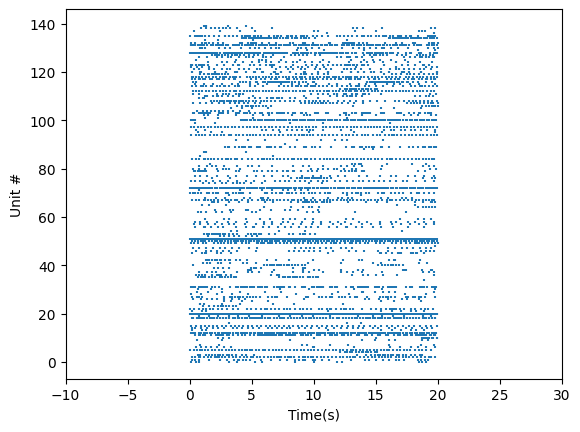


Firing rate plotted:
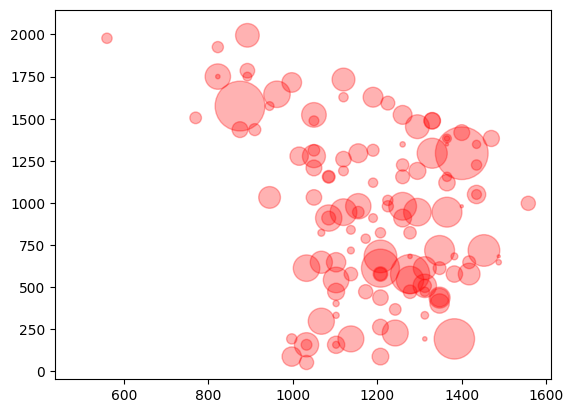

Corrs:

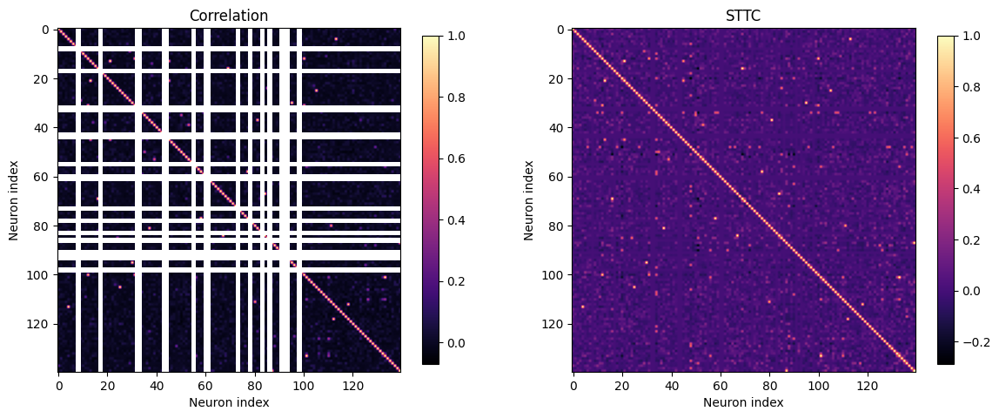

Threshold set to 1:
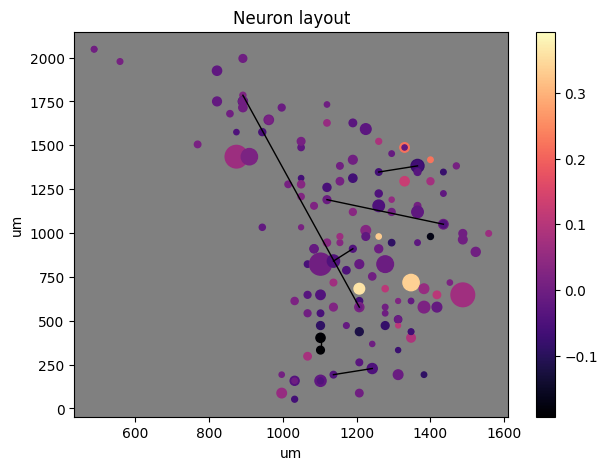


Threshold set to 0.9:
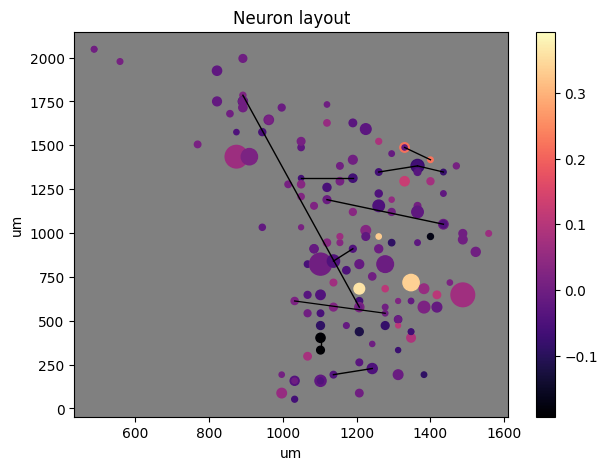


Threshold set to 0.75:
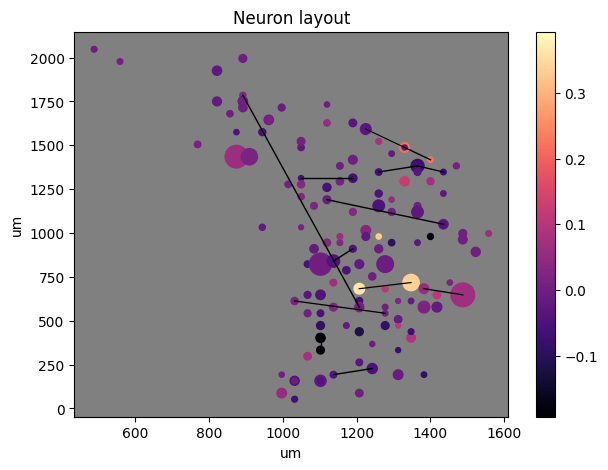


Threshold set to 0.5: 
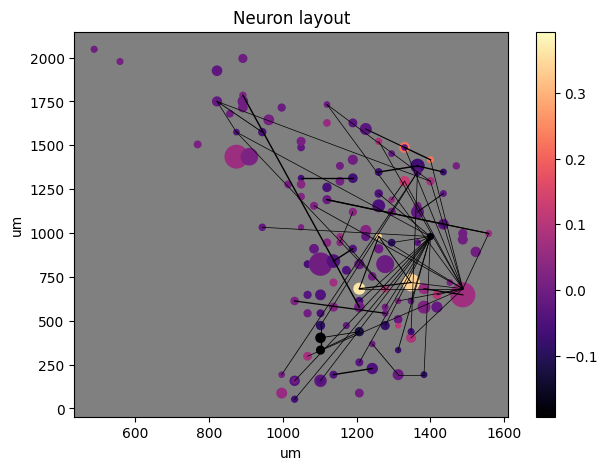


Threshold set to 0.25:
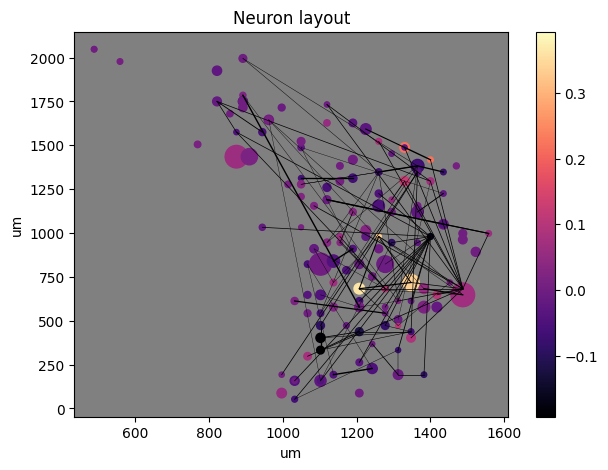


Threshold set to 0:
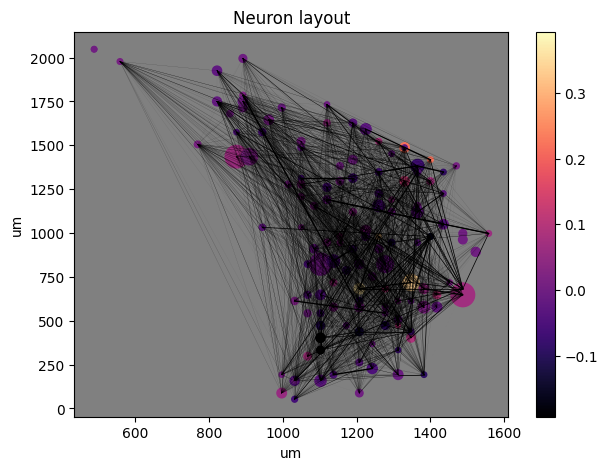

### <font color="brown">Stitched Data

#### Data Vis

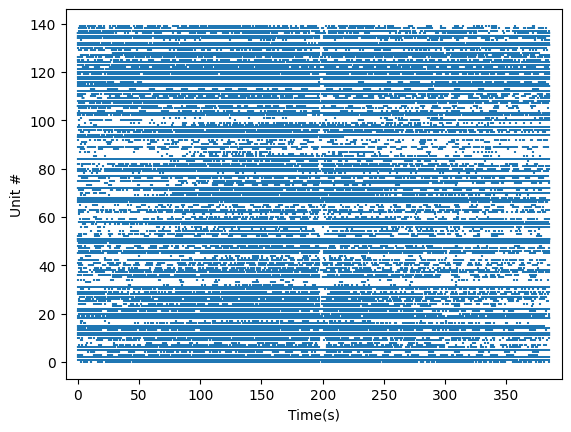

Stitched Firing Map
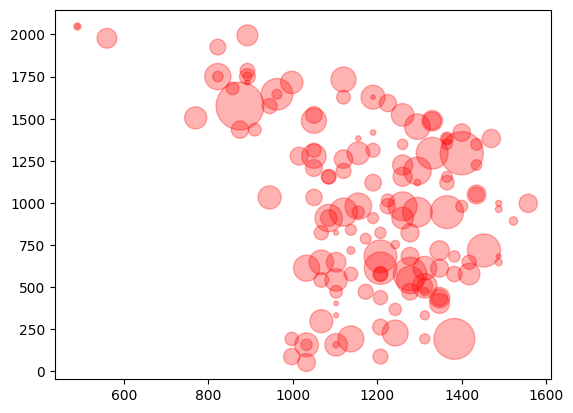

Corrs 
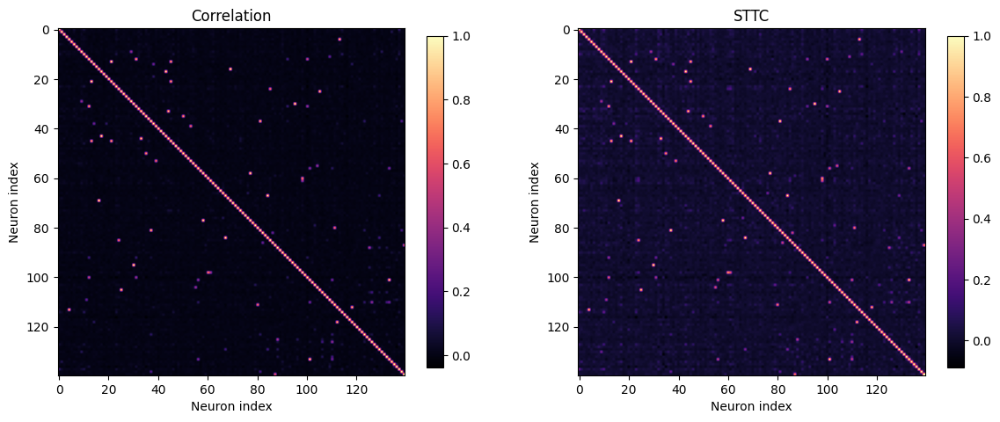

Threshold set to 1:
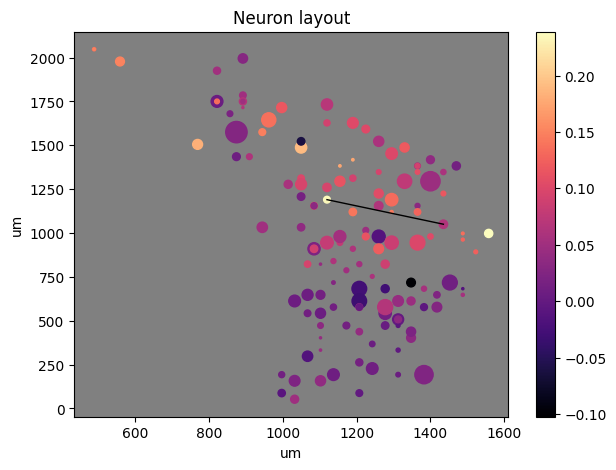


Threshold set to 0.9:
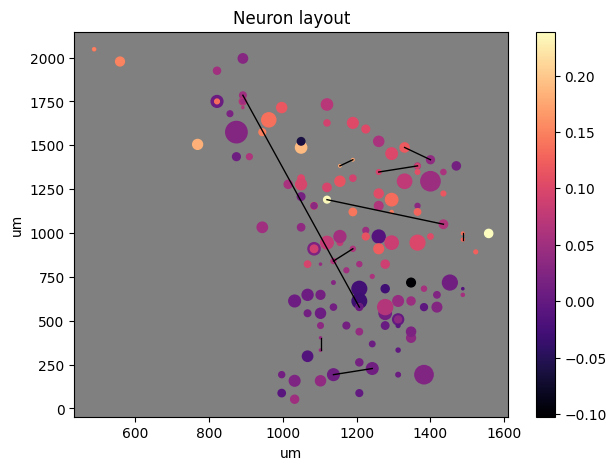


Threshold set to 0.75:
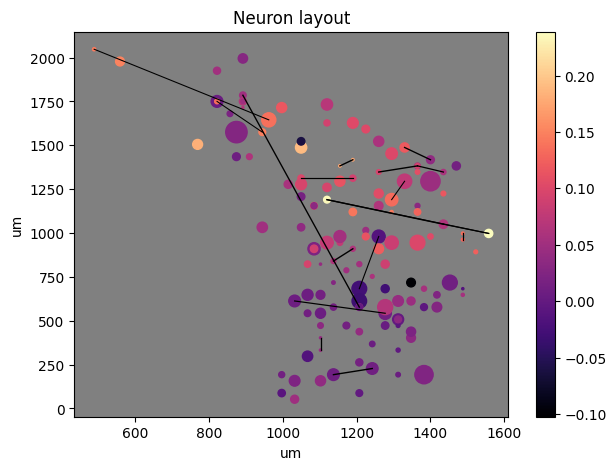


Threshold set to 0.5: 
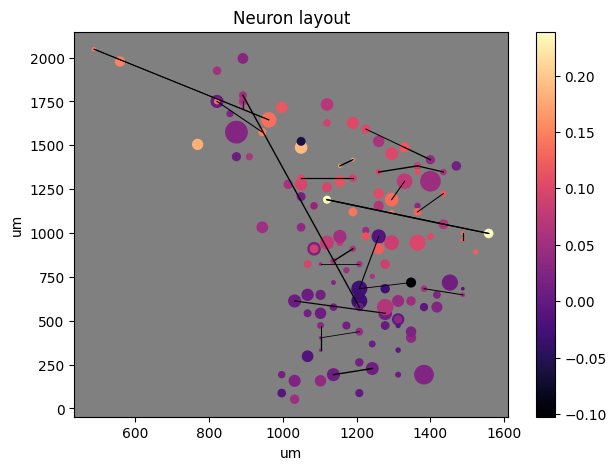


Threshold set to 0.25:
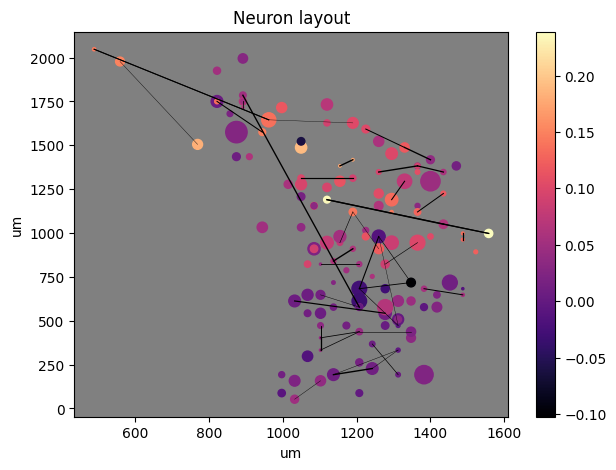


Threshold set to 0:
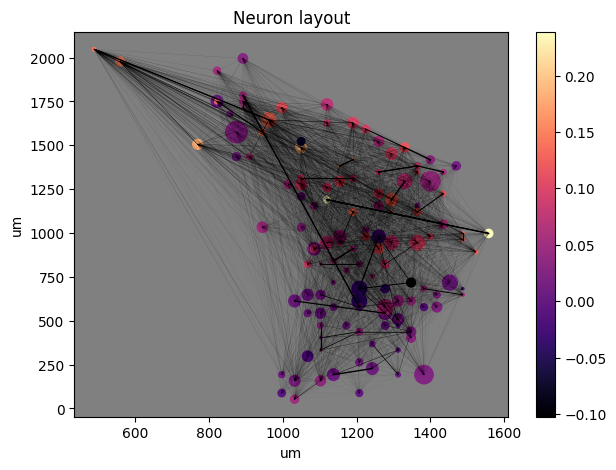

#### Randomized Plots


##### Run 1, seed:5000

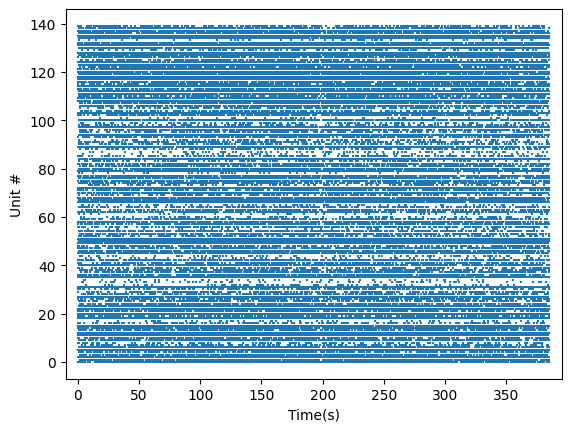
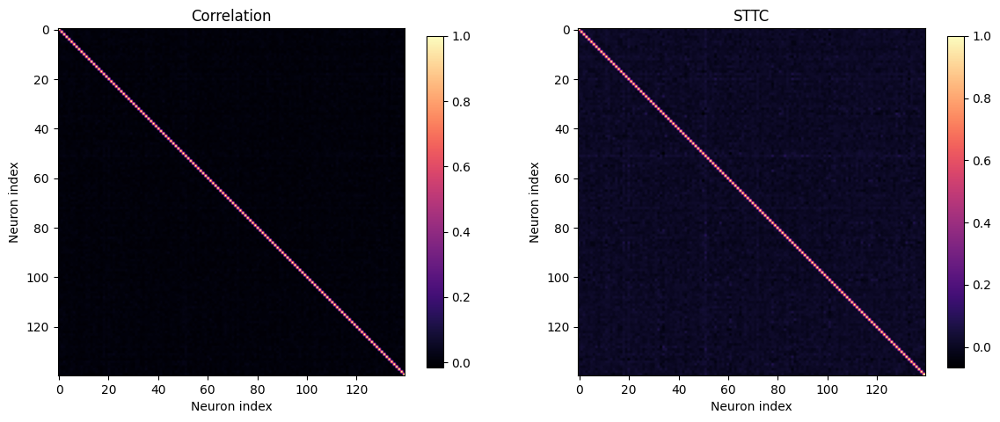
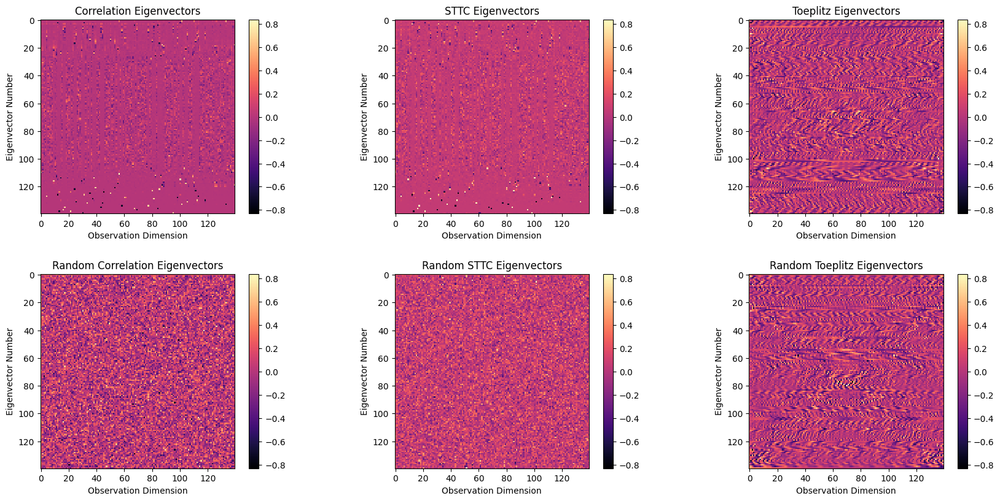

##### Run 2, seed:450

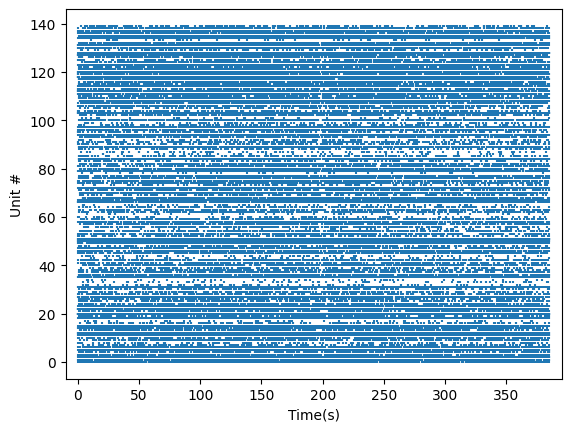
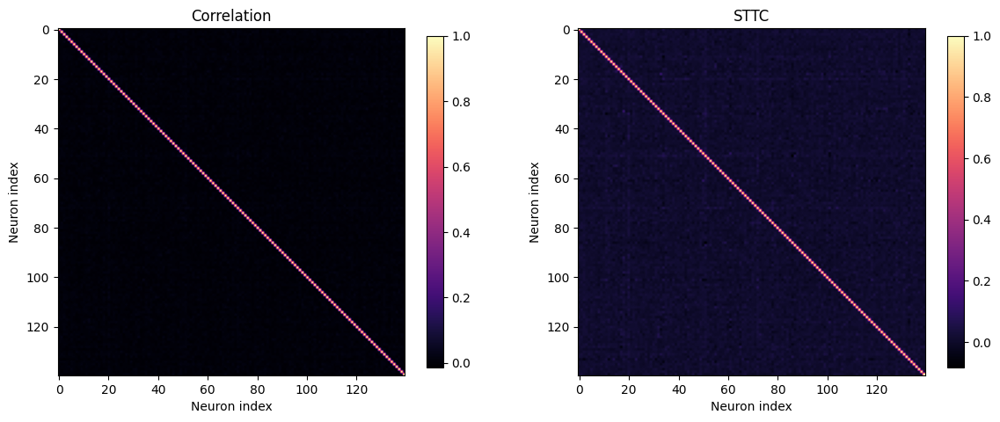
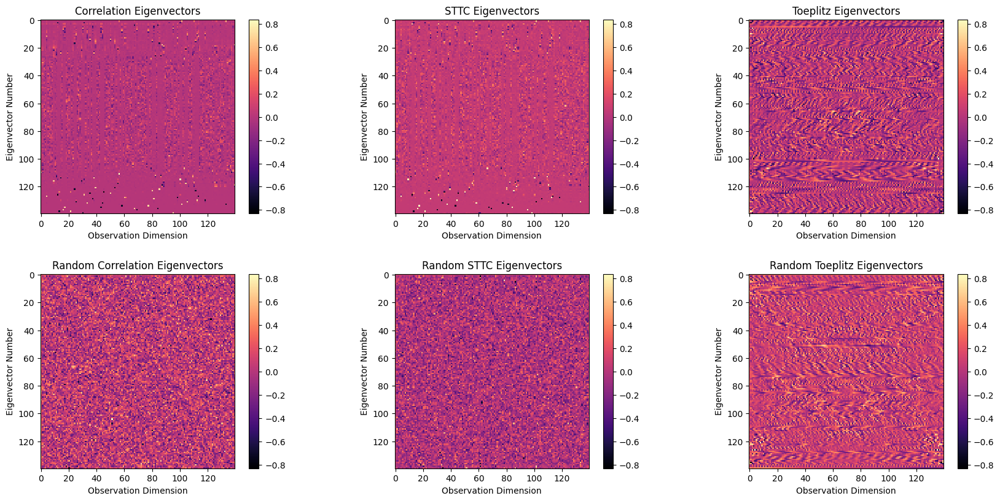

##### Run 3, seed:20

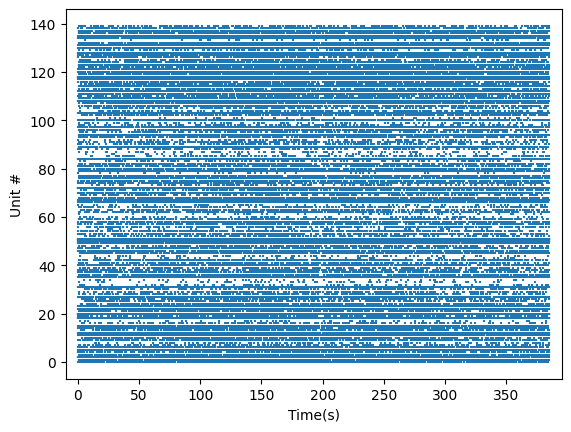
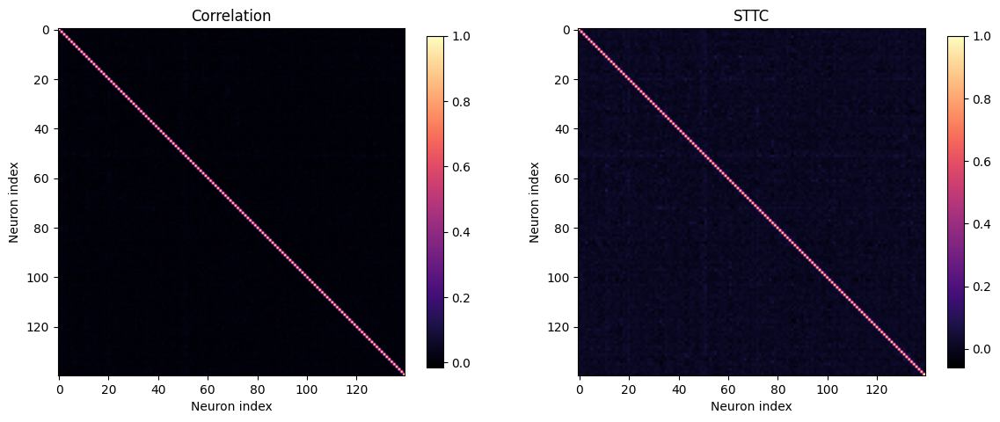
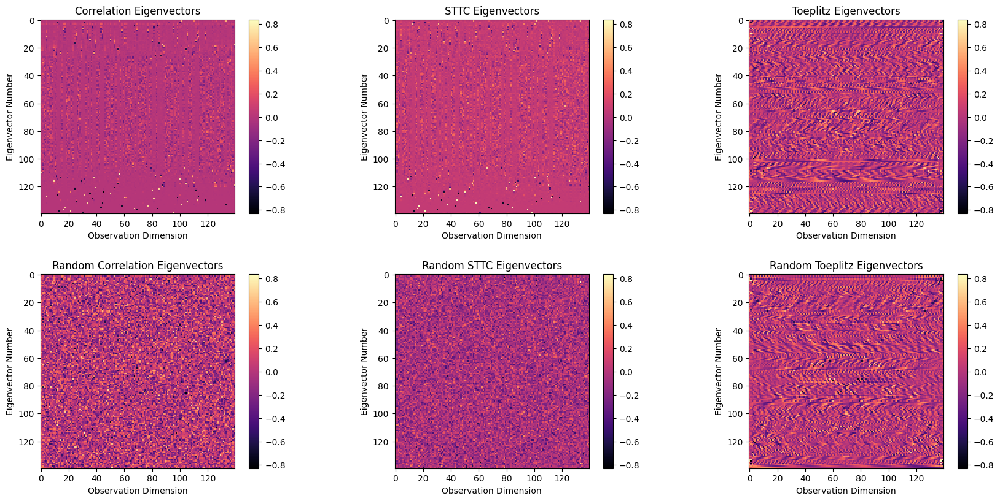

##### Run 4, seed:67

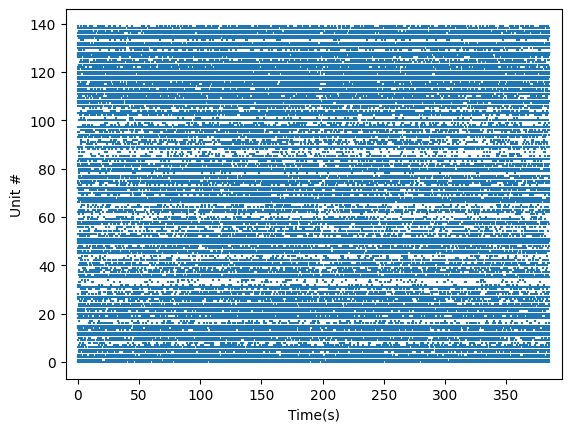
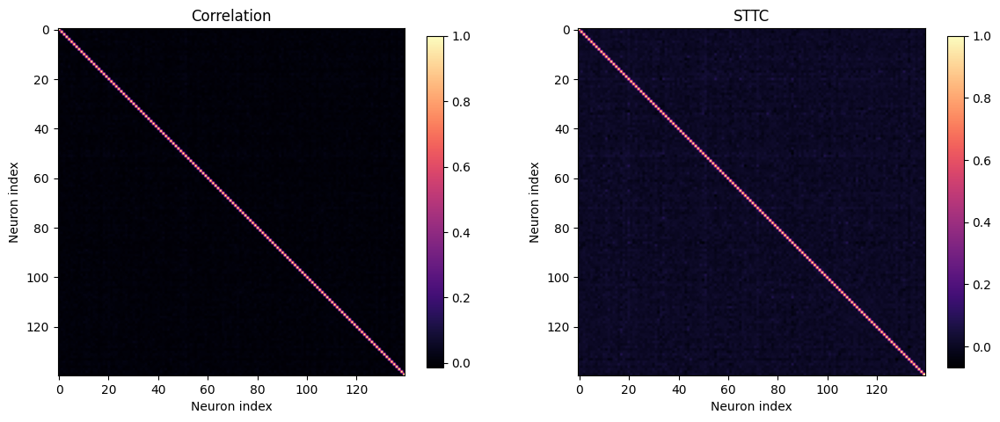
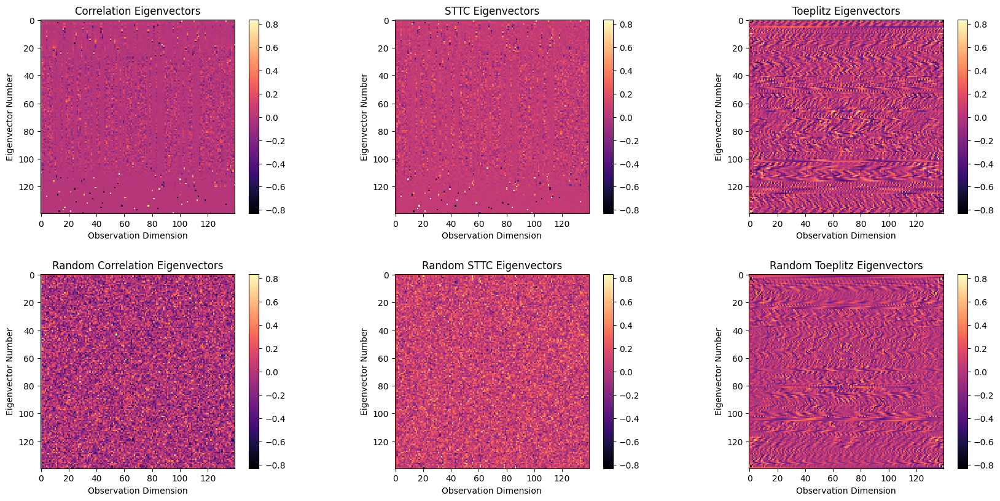

##### Run 5, seed:8763

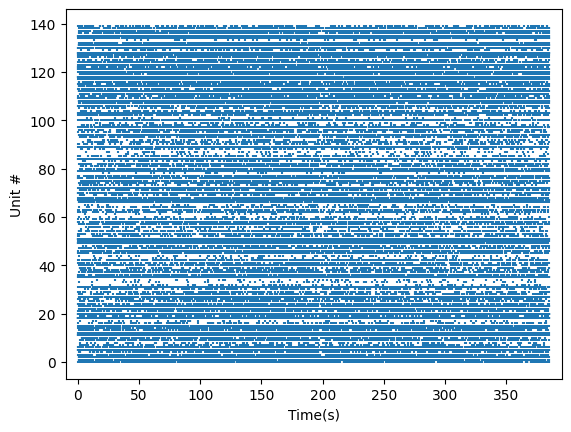
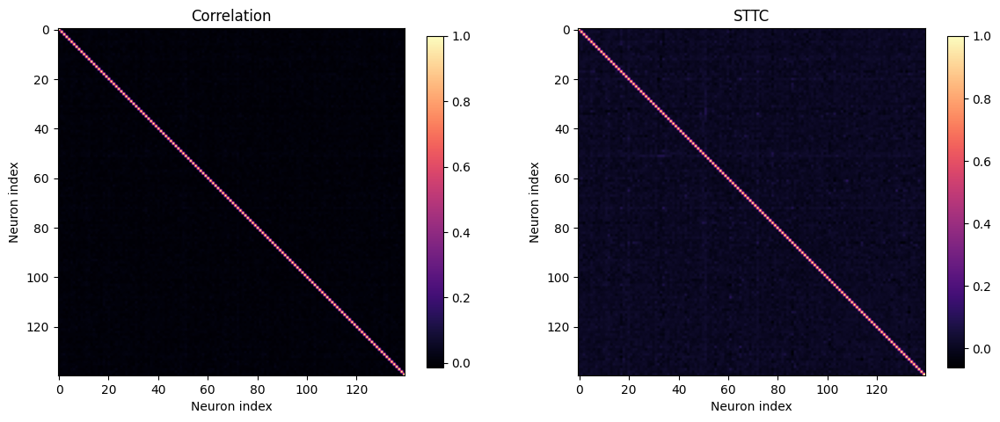
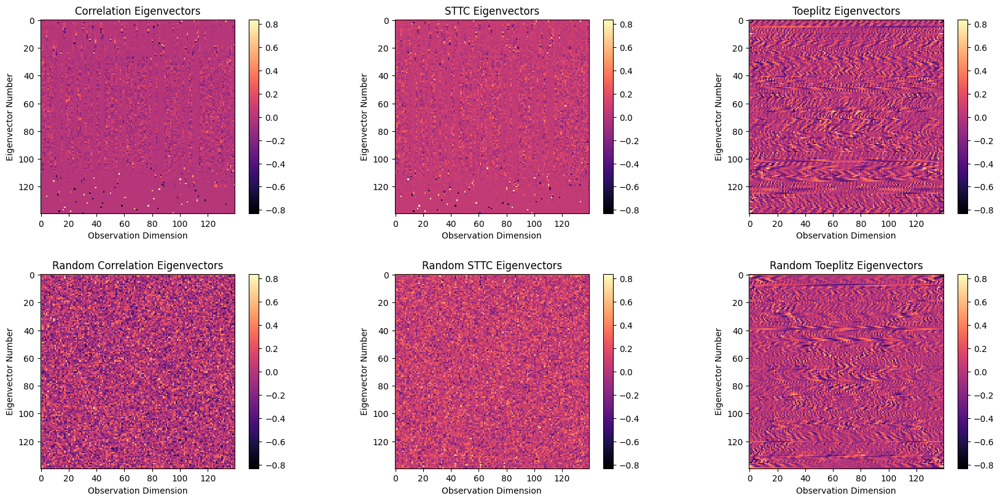

##### Run 6, seed:1209

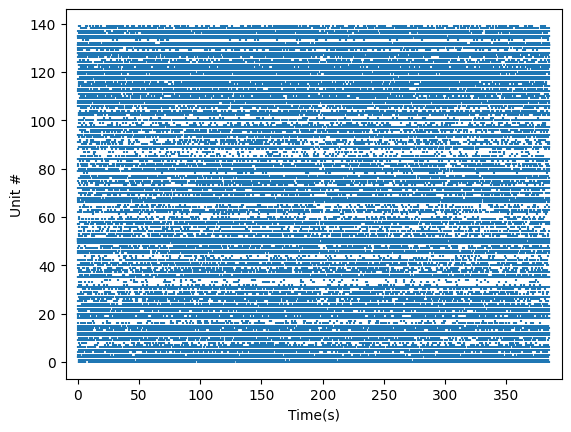
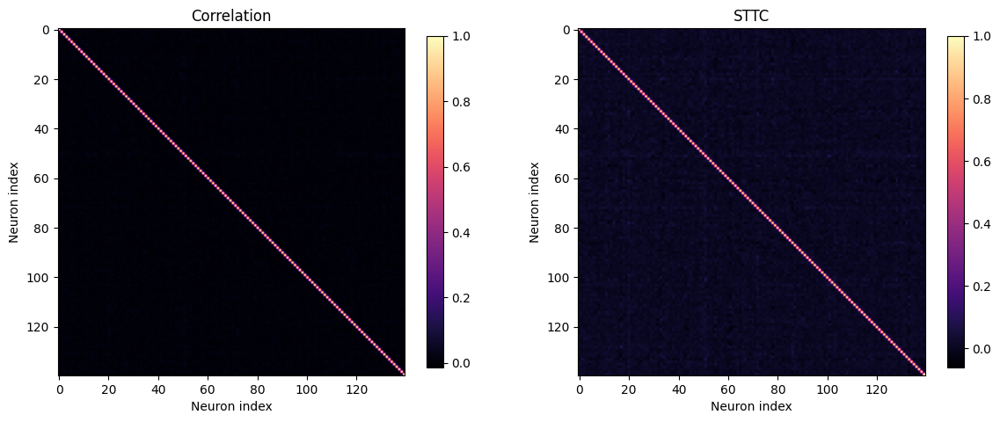
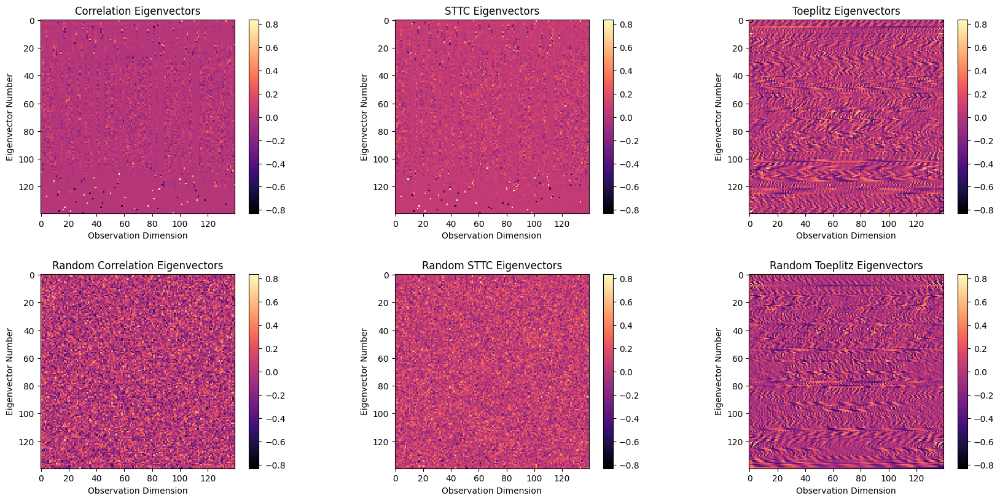

##### Run 7, seed:4568

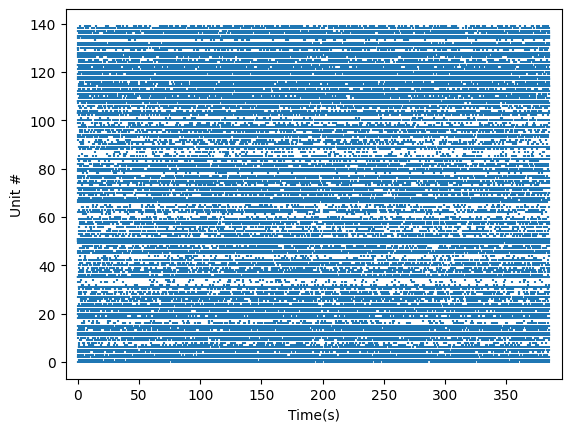
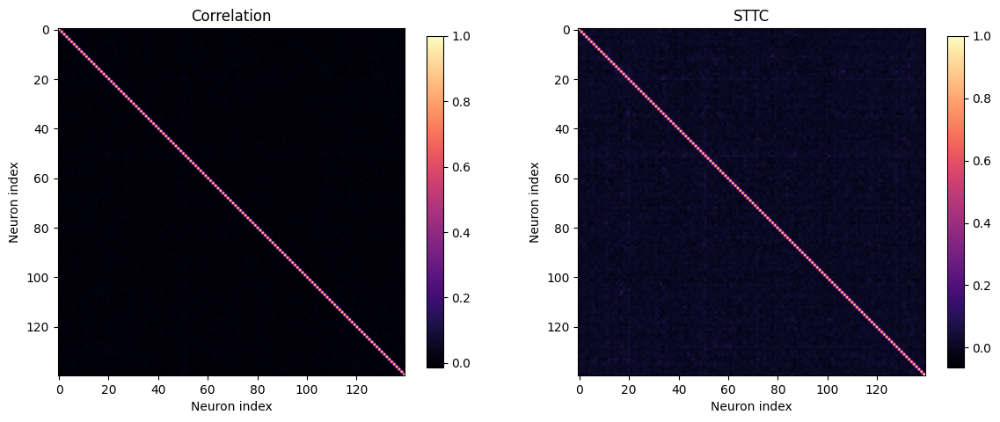
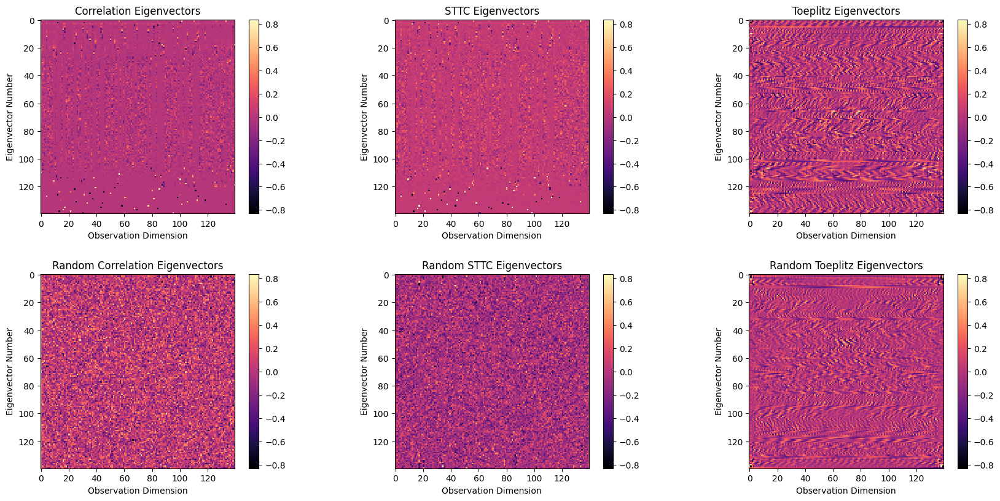

##### Run 8, seed:321

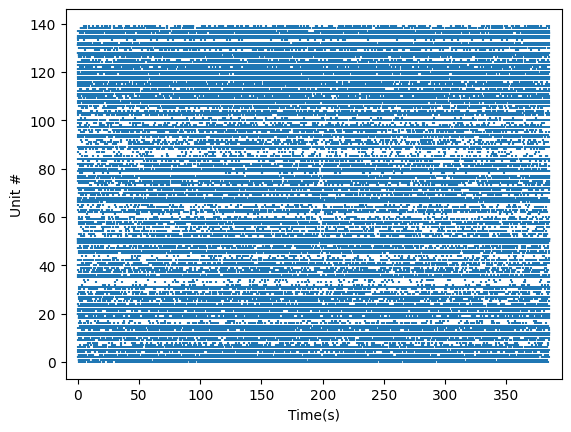
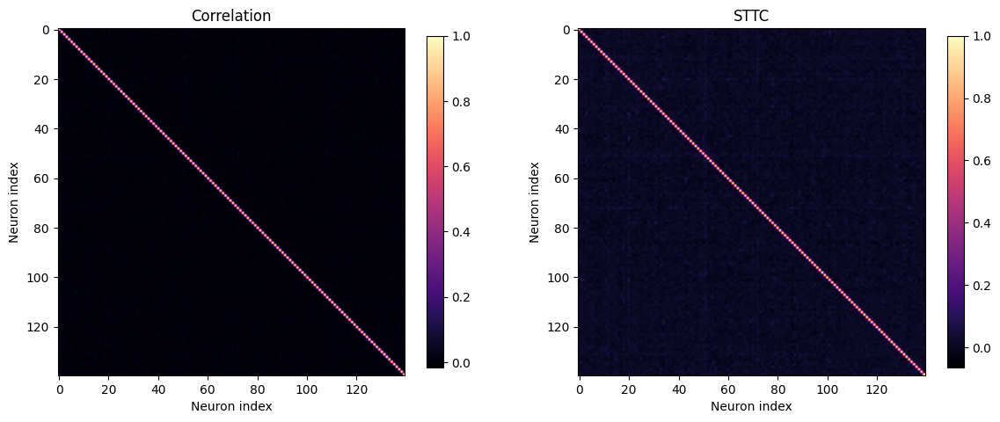
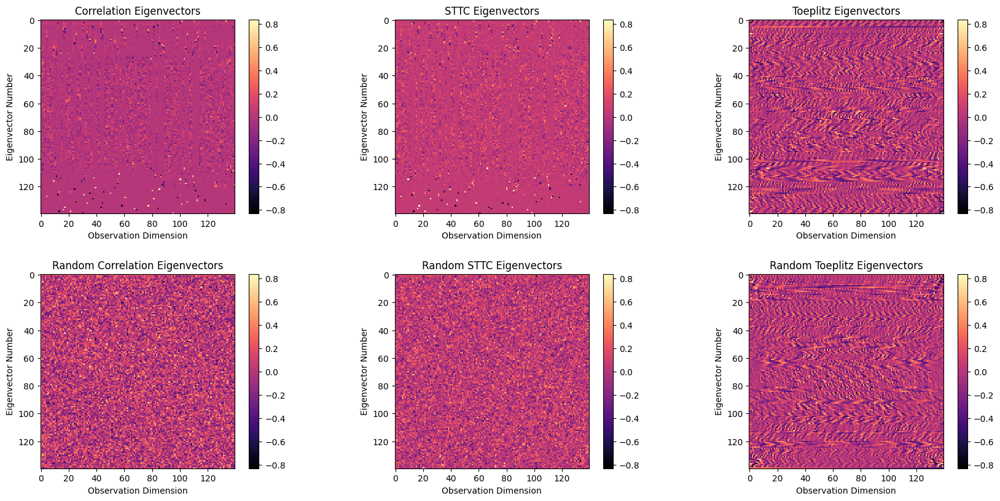

##### Run 9, seed:1111

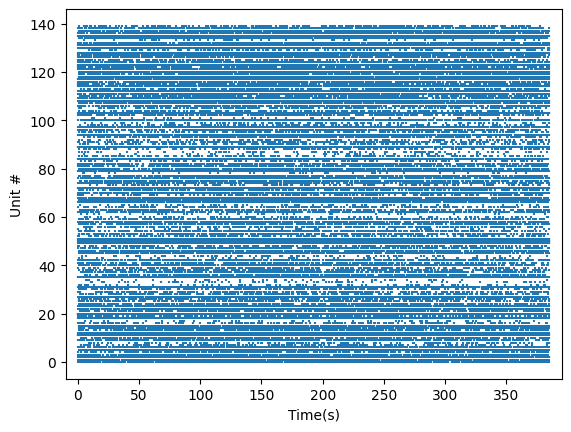
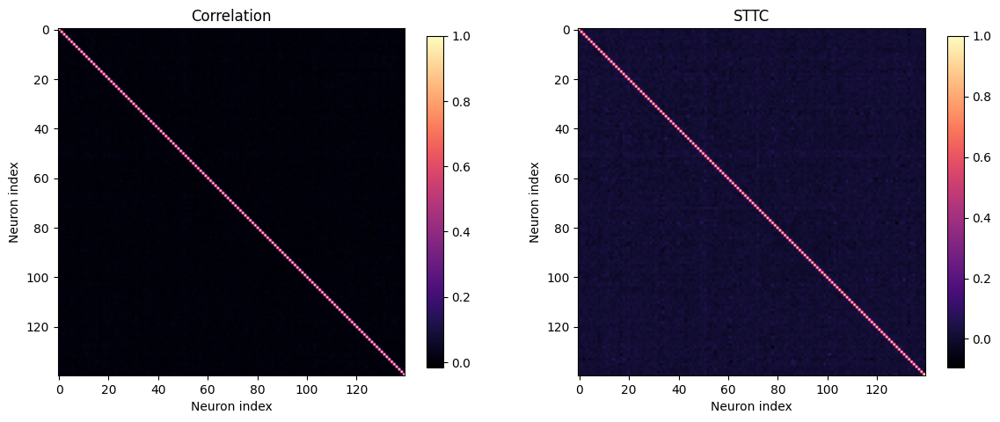
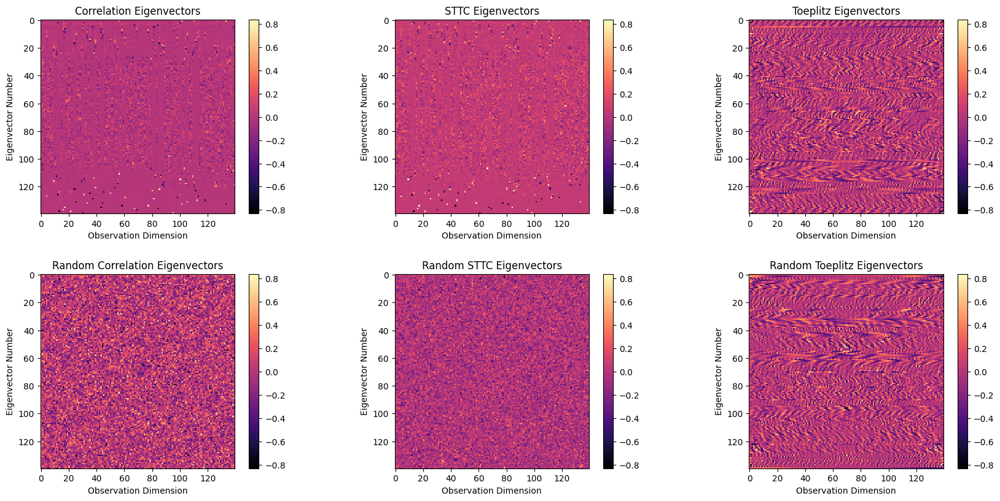

##### Run 10, seed:0

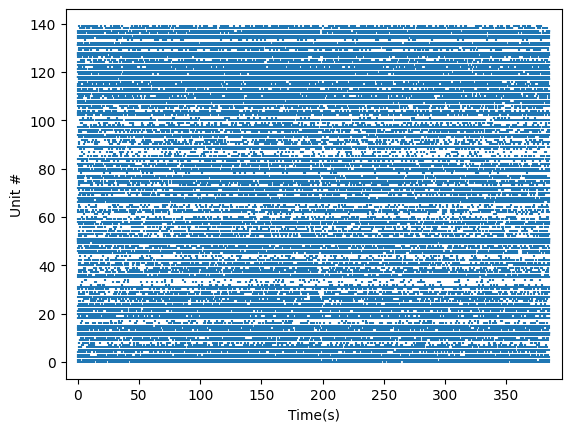
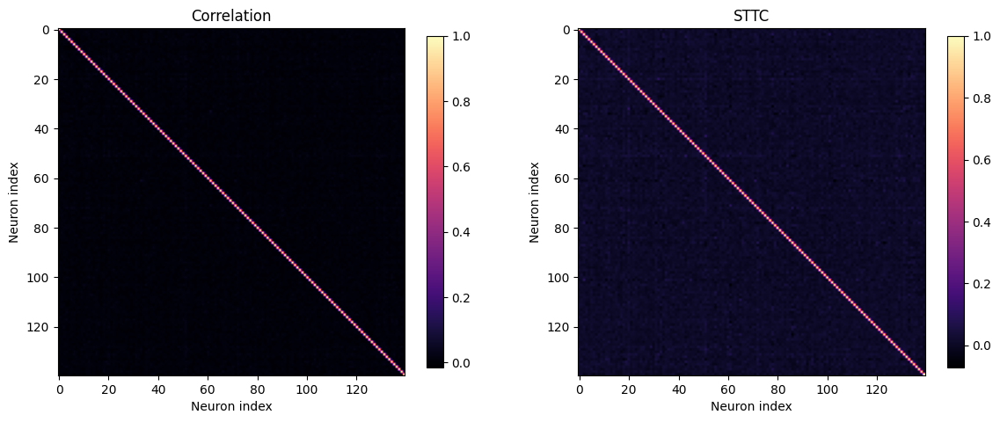
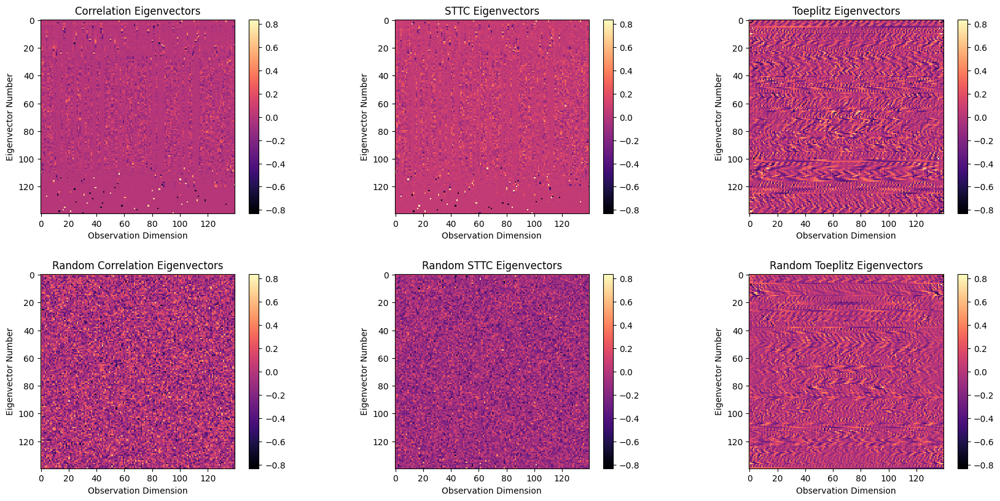